## 📢 주의사항
- **반드시 아래 명령어로 라이브러리 설치**  
  `pip install -r requirements.txt`  

- **첫 번째 셀 실행 시 시간이 걸릴 수 있음**  

- **XAI 부분은 특히 오래 걸림 (⚠️주의)**  


In [54]:
# ============================================
# 공통 설정: 라이브러리, 스타일, 데이터 준비
# ============================================
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# 경고 메시지 억제 (필요한 것만 표시)
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning, module='seaborn')
warnings.filterwarnings('ignore', category=UserWarning, module='IPython')
warnings.filterwarnings('ignore', category=UserWarning, module='sklearn')
warnings.filterwarnings('ignore', message='.*Glyph.*missing from font.*')
warnings.filterwarnings('ignore', message='.*TqdmWarning.*')
warnings.filterwarnings('ignore', message='.*A value is trying to be set on a copy of a slice.*')
warnings.filterwarnings('ignore', message='.*X does not have valid feature names.*')

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.inspection import permutation_importance, PartialDependenceDisplay

from statsmodels.graphics.mosaicplot import mosaic
import matplotlib.font_manager as fm
import squarify

# -------------------------------------------------------------------
# 0-1. 시각화 스타일 통합 (고화질, 컬러풀)
# -------------------------------------------------------------------
sns.set_theme(style="whitegrid", context="talk", palette="husl")  # 컬러풀한 팔레트
plt.rcParams["figure.figsize"] = (12, 8)  # 기본 크기 증가
plt.rcParams["figure.dpi"] = 300  # 고화질 설정
plt.rcParams["savefig.dpi"] = 300
plt.rcParams["axes.titlesize"] = 20  # 제목 크기 증가
plt.rcParams["axes.labelsize"] = 16  # 라벨 크기 증가
plt.rcParams["xtick.labelsize"] = 14  # x축 눈금 크기
plt.rcParams["ytick.labelsize"] = 14  # y축 눈금 크기
plt.rcParams["legend.fontsize"] = 14  # 범례 크기

# 한글 폰트 설정 (노트북 전체에 한 번만) - 강화 버전
import os
import platform

# 폰트 캐시 재생성 (필요시)
try:
    fm._rebuild()
except:
    pass

# Windows 시스템 폰트 경로
system_font_paths = []
if platform.system() == 'Windows':
    system_font_paths = [
        os.path.join(os.environ.get('WINDIR', 'C:\\Windows'), 'Fonts'),
        os.path.join(os.environ.get('LOCALAPPDATA', ''), 'Microsoft', 'Windows', 'Fonts'),
    ]

# 폰트 찾기: 이름 + 파일명 + 경로 모두 확인
font_list = [font.name for font in fm.fontManager.ttflist]
font_files = {font.name: font.fname for font in fm.fontManager.ttflist}

# 한글 폰트 후보 (다양한 이름 변형 포함)
korean_fonts = [
    'Malgun Gothic', '맑은 고딕', 'MalgunGothic',
    'NanumGothic', '나눔고딕', 'Nanum Gothic',
    'NanumBarunGothic', '나눔바른고딕', 'Nanum Barun Gothic',
    'AppleGothic', 'Apple Gothic',
    'Gulim', '굴림', 'GulimChe',
    'Dotum', '돋움', 'Batang', '바탕'
]

selected_font = None

# 방법 1: 폰트 이름으로 찾기
for f in korean_fonts:
    if f in font_list:
        selected_font = f
        print(f"✅ 한글 폰트 발견 (이름): {selected_font}")
        break

# 방법 2: 폰트 파일명으로 찾기 (이름으로 못 찾았을 때)
if not selected_font:
    font_file_names = {
        'malgun': ['Malgun Gothic', '맑은 고딕'],
        'nanumgothic': ['NanumGothic', '나눔고딕'],
        'nanumbarungothic': ['NanumBarunGothic', '나눔바른고딕'],
        'gulim': ['Gulim', '굴림'],
        'dotum': ['Dotum', '돋움']
    }
    
    for font_file, font_names in font_file_names.items():
        for font_name, font_path in font_files.items():
            if font_file.lower() in font_path.lower():
                # 해당 폰트 이름이 리스트에 있으면 사용
                for name in font_names:
                    if name in font_list:
                        selected_font = name
                        print(f"✅ 한글 폰트 발견 (파일명): {selected_font}")
                        break
                if selected_font:
                    break
        if selected_font:
            break

# 방법 3: 시스템 폰트 경로에서 직접 찾기
if not selected_font and system_font_paths:
    import glob
    for font_path in system_font_paths:
        if os.path.exists(font_path):
            # 맑은 고딕 찾기
            malgun_files = glob.glob(os.path.join(font_path, '*malgun*.ttf')) + \
                          glob.glob(os.path.join(font_path, '*맑은*.ttf'))
            if malgun_files:
                # 폰트 이름으로 다시 확인
                for f in ['Malgun Gothic', '맑은 고딕', 'MalgunGothic']:
                    if f in font_list:
                        selected_font = f
                        print(f"✅ 한글 폰트 발견 (시스템 경로): {selected_font}")
                        break
                if selected_font:
                    break

# 폰트 설정 적용
if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False
    print(f"✅ 한글 폰트 설정 완료: {selected_font}")
else:
    print("⚠️ 한글 폰트를 찾을 수 없습니다. 기본 폰트를 사용합니다.")
    print(f"   사용 가능한 폰트 샘플: {font_list[:10]}")
    # 최후 수단: sans-serif 계열 시도
    plt.rcParams['font.family'] = 'sans-serif'
    plt.rcParams['axes.unicode_minus'] = False

# 섹션 타이틀 출력용 함수
def print_section(title_ko, title_en=None):
    print("\n" + "=" * 70)
    print(f"{title_ko}")
    if title_en:
        print(f"({title_en})")
    print("=" * 70 + "\n")

# 데이터 준비 헬퍼 함수 (전역 변수로 사용 가능)
def ensure_df_scaled():
    """df_scaled가 준비되어 있는지 확인하고, 없으면 생성"""
    global df_scaled, feature_cols
    
    if 'df_scaled' in globals() and df_scaled is not None:
        # diagnosis가 숫자인지 확인
        if df_scaled['진단'].dtype == 'object':
            df_scaled['진단'] = df_scaled['진단'].map({'M': 1, 'B': 0, '악성(M)': 1, '양성(B)': 0})
            df_scaled['진단'] = pd.to_numeric(df_scaled['진단'], errors='coerce')
            df_scaled = df_scaled.dropna(subset=['진단'])
        return df_scaled
    
    # df_scaled가 없으면 생성
    print("⚠️ df_scaled를 생성합니다...")
    
    # 데이터 소스 선택
    if 'df_clean' in globals():
        df_temp = df_clean.copy()
    elif 'df_encoded' in globals():
        df_temp = df_encoded.copy()
    elif 'df' in globals():
        df_temp = df.copy()
        # diagnosis 인코딩
        if df_temp['진단'].dtype == 'object':
            df_temp['진단'] = df_temp['진단'].map({'M': 1, 'B': 0})
    else:
        raise ValueError("df, df_encoded, 또는 df_clean이 필요합니다.")
    
    # feature_cols 정의
    if 'feature_cols' not in globals() or feature_cols is None:
        feature_cols = [col for col in df_temp.columns if col not in ['id', '진단', 'Unnamed: 32']]
    
    # 정규화
    from sklearn.preprocessing import StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(df_temp[feature_cols])
    df_scaled = pd.DataFrame(X_scaled, columns=feature_cols)
    df_scaled['진단'] = pd.to_numeric(df_temp['진단'], errors='coerce')
    
    # NaN 제거
    df_scaled = df_scaled.dropna(subset=['진단'])
    
    print("✅ df_scaled 생성 완료")
    return df_scaled

# -------------------------------------------------------------------
# 0-2. 데이터 로드 & 전처리
# -------------------------------------------------------------------
data_path = "kr_data.csv"   # 파일 경로 맞게 조정
df = pd.read_csv(data_path)

print_section("데이터 기본 정보 요약", "Basic Data Summary")
print(f"데이터 shape: {df.shape}")
print(f"컬럼 수: {len(df.columns)}")
print("\n진단 분포 (0=Benign, 1=Malignant):")
print(df['진단'].value_counts())
print("\n결측치 개수:", df.isnull().sum().sum())

# 특징 / 타깃 분리
target_col = '진단'
# id, diagnosis, Unnamed: 32 제외
feature_cols = [c for c in df.columns if c not in [target_col, 'id', 'Unnamed: 32']]

# diagnosis 인코딩 (M=1, B=0) - 문자열이면 숫자로 변환
if df[target_col].dtype == 'object':
    y = df[target_col].map({'M': 1, 'B': 0})
else:
    y = df[target_col]

X_raw = df[feature_cols]

# 스케일링
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_raw)
df_scaled = pd.DataFrame(X_scaled, columns=feature_cols)
df_scaled[target_col] = y.values

# diagnosis가 숫자인지 확인
if df_scaled[target_col].dtype == 'object':
    df_scaled[target_col] = pd.to_numeric(df_scaled[target_col], errors='coerce')

# 학습/테스트 분할
X_train, X_test, y_train, y_test = train_test_split(
    df_scaled[feature_cols],
    df_scaled[target_col],
    test_size=0.2,
    random_state=42,
    stratify=df_scaled[target_col]
)

# 모델 학습 (RandomForest + DecisionTree)
rf_clf = RandomForestClassifier(
    n_estimators=200,
    max_depth=None,
    random_state=42,
    n_jobs=-1
)
rf_clf.fit(X_train, y_train)

dt_clf = DecisionTreeClassifier(
    max_depth=4,
    random_state=42
)
dt_clf.fit(X_train, y_train)

print("✅ 데이터 전처리 및 기본 모델 학습 완료")


✅ 한글 폰트 발견 (이름): Malgun Gothic
✅ 한글 폰트 설정 완료: Malgun Gothic

데이터 기본 정보 요약
(Basic Data Summary)

데이터 shape: (569, 32)
컬럼 수: 32

진단 분포 (0=Benign, 1=Malignant):
진단
B    357
M    212
Name: count, dtype: int64

결측치 개수: 0
✅ 데이터 전처리 및 기본 모델 학습 완료


In [55]:
# 데이터 로드
data_path = "kr_data.csv"
df = pd.read_csv(data_path)

print(f"데이터 shape: {df.shape}")
print(f"\n컬럼 목록:\n{df.columns.tolist()}")
print(f"\n결측치 확인:\n{df.isnull().sum().sum()}개")
print(f"\n데이터 타입:\n{df.dtypes}")
print(f"\n진단 분포:\n{df['진단'].value_counts()}")

df.head()


데이터 shape: (569, 32)

컬럼 목록:
['id', '진단', '반경 평균', '조직 평균', '둘레 길이 평균', '면적 평균', '매끄러움 평균', '치밀도 평균', '오목함 평균', '오목한 포인트 개수 평균', '좌우 대칭도 평균', '경계 불규칙성 평균', '반경 표준오차', '조직 표준오차', '둘레 길이 표준오차', '면적 표준오차', '매끄러움 표준오차', '치밀도 표준오차', '오목함 표준오차', '오목한 포인트 개수 표준오차', '좌우 대칭도 표준오차 ', '경계 불규칙성 표준오차', '반경 최악상태', '조직 최악상태', '둘레 길이 최악상태', '면적 최악상태', '매끄러움 최악상태', '치밀도 최악상태', '오목함 최악상태', '오목한 포인트 개수 최악상태', '대칭성 최악상태', '경계 불규칙성 최악상태']

결측치 확인:
0개

데이터 타입:
id                   int64
진단                  object
반경 평균              float64
조직 평균              float64
둘레 길이 평균           float64
면적 평균              float64
매끄러움 평균            float64
치밀도 평균             float64
오목함 평균             float64
오목한 포인트 개수 평균      float64
좌우 대칭도 평균          float64
경계 불규칙성 평균         float64
반경 표준오차            float64
조직 표준오차            float64
둘레 길이 표준오차         float64
면적 표준오차            float64
매끄러움 표준오차          float64
치밀도 표준오차           float64
오목함 표준오차           float64
오목한 포인트 개수 표준오차    float64
좌우 대칭도 표준오차      

,id,진단,반경 평균,조직 평균,둘레 길이 평균,면적 평균,매끄러움 평균,치밀도 평균,오목함 평균,오목한 포인트 개수 평균,...,반경 최악상태,조직 최악상태,둘레 길이 최악상태,면적 최악상태,매끄러움 최악상태,치밀도 최악상태,오목함 최악상태,오목한 포인트 개수 최악상태,대칭성 최악상태,경계 불규칙성 최악상태
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678



시각화: 초기 Boxplot (이상치 탐색)
(Initial Feature Boxplots)



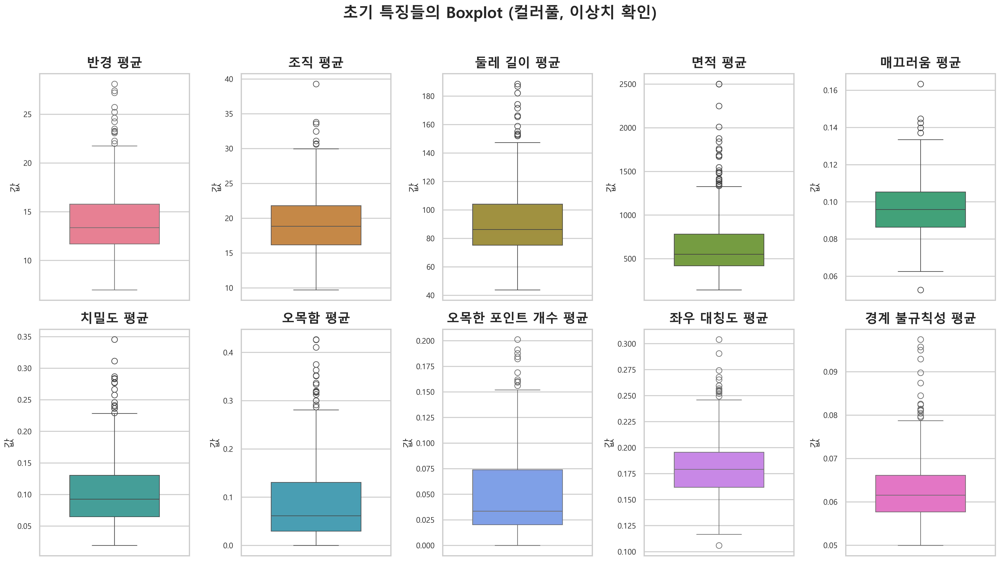

Boxplot 분석: 각 특징별 분포 차이 및 이상치 존재 확인됨


In [56]:
# ============================================
# 초기 Boxplot으로 이상치 확인 (컬러풀 버전)
# ============================================

print_section("시각화: 초기 Boxplot (이상치 탐색)", "Initial Feature Boxplots")

# Boxplot 대상 특징 (예: 처음 10개)
features = df.columns[2:12]
num_features = len(features)

# 컬러 팔레트 생성 (더 컬러풀한 팔레트)
colors = sns.color_palette("husl", num_features)  # 생생한 색상 팔레트

fig, axes = plt.subplots(2, 5, figsize=(22, 12), dpi=300)
axes = axes.flatten()  # 1D 배열 변환

for i, (ax, feature) in enumerate(zip(axes, features)):
    sns.boxplot(
        y=df[feature],
        ax=ax,
        color=colors[i],   # <-- 핵심: 컬러 개별 적용
        orient="v",
        width=0.6
    )
    if selected_font:
        ax.set_title(feature, fontsize=20, fontweight='bold', fontfamily=selected_font, pad=10)
        ax.set_ylabel("값", fontsize=16, fontfamily=selected_font)
    else:
        ax.set_title(feature, fontsize=20, fontweight='bold', pad=10)
        ax.set_ylabel("값", fontsize=16)
    ax.set_xlabel("")
    ax.tick_params(axis='y', labelsize=12)

# 빈 subplot 제거
for ax in axes[num_features:]:
    ax.remove()

if selected_font:
    plt.suptitle("초기 특징들의 Boxplot (컬러풀, 이상치 확인)", fontsize=24, y=1.02, fontweight='bold', fontfamily=selected_font)
else:
    plt.suptitle("초기 특징들의 Boxplot (컬러풀, 이상치 확인)", fontsize=24, y=1.02, fontweight='bold')
plt.tight_layout()
plt.show()

print("Boxplot 분석: 각 특징별 분포 차이 및 이상치 존재 확인됨")


In [57]:
# ============================================
# 1단계: 데이터 인코딩 (M=1, B=0)
# ============================================
print("=" * 50)
print("1단계: 진단 라벨 인코딩")
print("=" * 50)

df_encoded = df.copy()
# M(악성) = 1, B(양성) = 0으로 인코딩
df_encoded['진단'] = df_encoded['진단'].map({'M': 1, 'B': 0})

print(f"인코딩 후 진단 분포:")
print(df_encoded['진단'].value_counts().sort_index())
print(f"\n인코딩 확인: M -> {df_encoded[df['진단']=='M']['진단'].iloc[0]}, B -> {df_encoded[df['진단']=='B']['진단'].iloc[0]}")

# 특징 컬럼 선택 (id와 diagnosis 제외)
feature_cols = [col for col in df_encoded.columns if col not in ['id', '진단']]
print(f"\n특징 개수: {len(feature_cols)}개")

df_encoded.head()


1단계: 진단 라벨 인코딩
인코딩 후 진단 분포:
진단
0    357
1    212
Name: count, dtype: int64

인코딩 확인: M -> 1, B -> 0

특징 개수: 30개


,id,진단,반경 평균,조직 평균,둘레 길이 평균,면적 평균,매끄러움 평균,치밀도 평균,오목함 평균,오목한 포인트 개수 평균,...,반경 최악상태,조직 최악상태,둘레 길이 최악상태,면적 최악상태,매끄러움 최악상태,치밀도 최악상태,오목함 최악상태,오목한 포인트 개수 최악상태,대칭성 최악상태,경계 불규칙성 최악상태
0,842302,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


2단계: 이상치 처리 (IQR 방법)
df_encoded 사용
이상치가 있는 행 수: 171개
원본 데이터: 569행
⚠️ 이상치 비율이 높아 제거 대신 클리핑을 사용합니다.
클리핑 완료: 이상치를 경계값으로 제한했습니다.


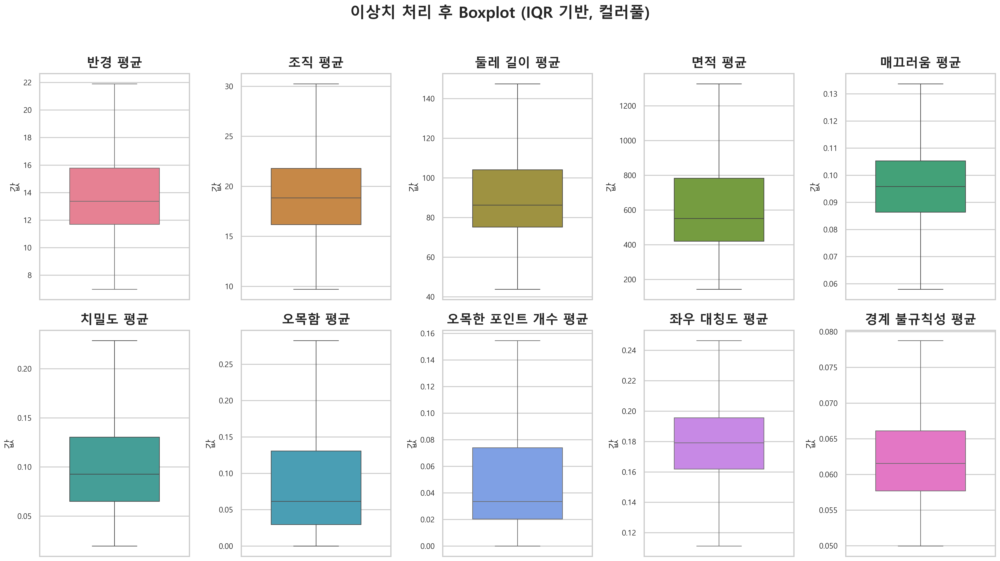

이상치 처리 후 Boxplot: 각 특징별 분포 변화와 이상치 감소 여부를 시각적으로 확인할 수 있음.


In [58]:
# ============================================
# 2단계: 이상치 처리 (IQR 방법)
# ============================================
print("=" * 50)
print("2단계: 이상치 처리 (IQR 방법)")
print("=" * 50)

# 한글 폰트 재확인 및 적용
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# df_encoded가 있으면 사용, 없으면 df 사용
if 'df_encoded' in globals():
    df_temp = df_encoded.copy()
    print("df_encoded 사용")
else:
    df_temp = df.copy()
    print("df 사용")

# 특징 컬럼 선택 (id와 diagnosis 제외)
feature_cols_clean = [col for col in df_temp.columns if col not in ['id', '진단', 'Unnamed: 32']]

# IQR 방법으로 이상치 처리
df_clean = df_temp.copy()
outlier_count = 0
outlier_rows = set()

for col in feature_cols_clean:
    if df_clean[col].dtype in [np.int64, np.float64]:
        Q1 = df_clean[col].quantile(0.25)
        Q3 = df_clean[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        outliers = (df_clean[col] < lower_bound) | (df_clean[col] > upper_bound)
        outlier_rows.update(df_clean[outliers].index.tolist())
        outlier_count += outliers.sum()

print(f"이상치가 있는 행 수: {len(outlier_rows)}개")
print(f"원본 데이터: {len(df_clean)}행")

# 이상치 제거 대신 클리핑(경계값으로 제한) 사용 (이상치 비율이 높을 경우)
if len(outlier_rows) > len(df_clean) * 0.3:
    print("⚠️ 이상치 비율이 높아 제거 대신 클리핑을 사용합니다.")
    for col in feature_cols_clean:
        if df_clean[col].dtype in [np.int64, np.float64]:
            Q1 = df_clean[col].quantile(0.25)
            Q3 = df_clean[col].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            df_clean[col] = df_clean[col].clip(lower_bound, upper_bound)
    print("클리핑 완료: 이상치를 경계값으로 제한했습니다.")
else:
    # 이상치 제거
    df_clean = df_clean.drop(index=outlier_rows)
    print(f"이상치 제거 완료: {len(df_clean)}행 남음")

# ============================================
# 이상치 처리 후 Boxplot (컬러풀 버전)
# ============================================

# features 정의
features = df.columns[2:12].tolist()  # 처음에 썼던 features와 동일하게 유지

# df_clean에 존재하는 features만 사용
available_features = [f for f in features if f in df_clean.columns]

if len(available_features) == 0:
    print("⚠️ 사용 가능한 특징이 없습니다. 원본 df 사용")
    df_clean = df.copy()
    available_features = features

num_features = len(available_features)
colors = sns.color_palette("husl", num_features)  # 컬러풀한 색상 팔레트

fig, axes = plt.subplots(2, 5, figsize=(22, 12), dpi=300)
axes = axes.flatten()

for i, (ax, feature) in enumerate(zip(axes, available_features)):
    if feature in df_clean.columns:
        sns.boxplot(
            y=df_clean[feature],
            ax=ax,
            color=colors[i],   # ← 각 feature마다 다른 색상
            orient="v",
            width=0.6
        )
        if selected_font:
            ax.set_title(feature, fontsize=20, fontweight='bold', fontfamily=selected_font, pad=10)
            ax.set_ylabel("값", fontsize=16, fontfamily=selected_font)
        else:
            ax.set_title(feature, fontsize=20, fontweight='bold', pad=10)
            ax.set_ylabel("값", fontsize=16)
        ax.set_xlabel("")
        ax.tick_params(axis='y', labelsize=12)
    else:
        ax.text(0.5, 0.5, f'{feature}\n(데이터 없음)', 
                ha='center', va='center', transform=ax.transAxes)
        ax.set_title(feature, fontsize=18, fontweight='bold')

# 남는 subplot 제거
for ax in axes[num_features:]:
    ax.remove()

title_text = "이상치 처리 후 Boxplot (IQR 기반, 컬러풀)"
if selected_font:
    plt.suptitle(title_text, fontsize=24, y=1.02, fontweight='bold', fontfamily=selected_font)
else:
    plt.suptitle(title_text, fontsize=24, y=1.02, fontweight='bold')

plt.tight_layout()
plt.show()

print("이상치 처리 후 Boxplot: 각 특징별 분포 변화와 이상치 감소 여부를 시각적으로 확인할 수 있음.")


시각화 1: 상관관계 히트맵


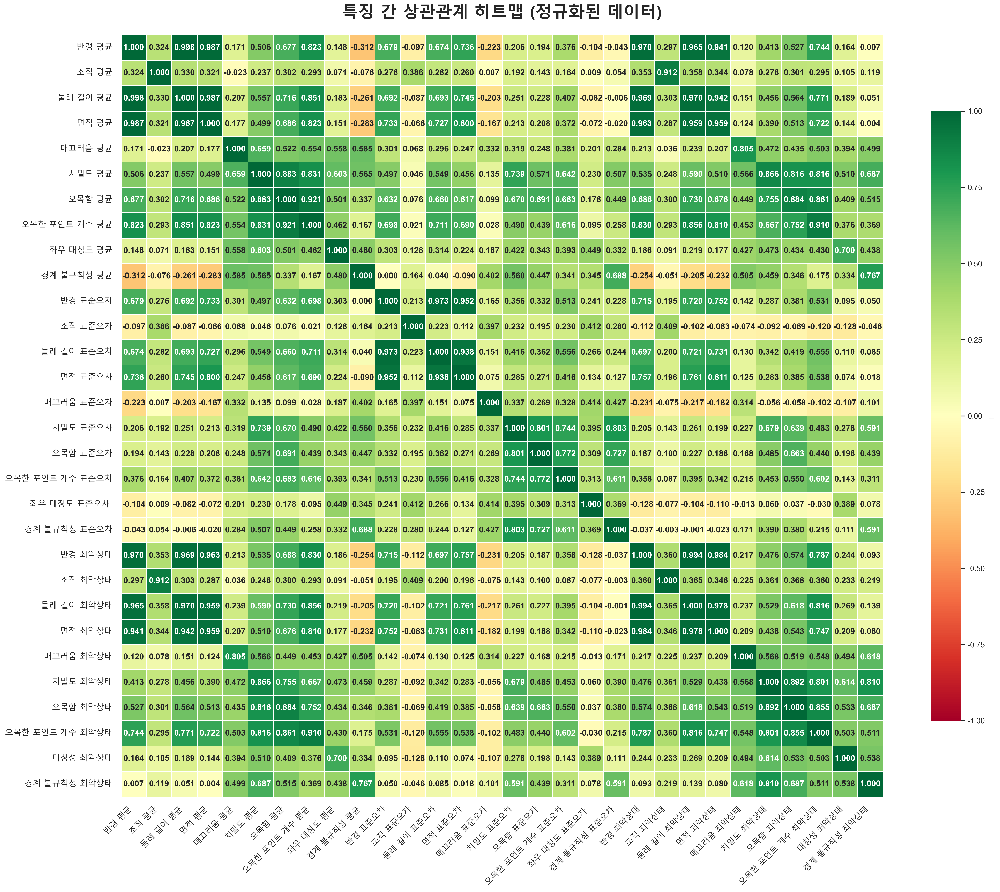

✅ 히트맵 완료: 각 칸에 상관계수가 소수점 4자리까지 표시됩니다.


In [59]:
# ============================================
# 시각화 1: 상관관계 히트맵
# ============================================
print("=" * 50)
print("시각화 1: 상관관계 히트맵")
print("=" * 50)

# df_scaled와 feature_cols 확인
ensure_df_scaled()

# df_scaled에 실제로 존재하는 컬럼만 사용
feature_cols_in_scaled = [c for c in feature_cols if c in df_scaled.columns]

# 상관계수 행렬 계산
corr_matrix = df_scaled[feature_cols_in_scaled].corr()

# 히트맵 생성 (컬러풀한 색상, 고화질)
fig, ax = plt.subplots(figsize=(22, 18), dpi=300)
sns.set(style="whitegrid", font_scale=1.0)

n_features = len(feature_cols_in_scaled)
font_size = max(8, min(12, 400 // n_features))  # 동적 폰트 크기 증가

# 더 컬러풀한 컬러맵 사용
heatmap = sns.heatmap(
    corr_matrix,
    cmap='RdYlGn',  # 빨강-노랑-초록 컬러맵
    center=0,
    linewidths=0.8,
    annot=True,      # 숫자 표시
    fmt='.3f',       # 소수점 3자리까지
    square=True,
    cbar_kws={"shrink": 0.8, "label": "상관계수"},
    annot_kws={"size": font_size, "weight": "bold"},
    ax=ax,
    vmin=-1,
    vmax=1
)

title = '특징 간 상관관계 히트맵 (정규화된 데이터)'
if selected_font:
    ax.set_title(title, fontsize=24, pad=25,
                 fontweight='bold', fontfamily=selected_font)
else:
    ax.set_title(title, fontsize=24, pad=25, fontweight='bold')

ax.set_xlabel('', fontsize=22)
ax.set_ylabel('', fontsize=22)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.tight_layout()
plt.show()

print("✅ 히트맵 완료: 각 칸에 상관계수가 소수점 4자리까지 표시됩니다.")


시각화 1-2: 주요 특징 상관관계 히트맵


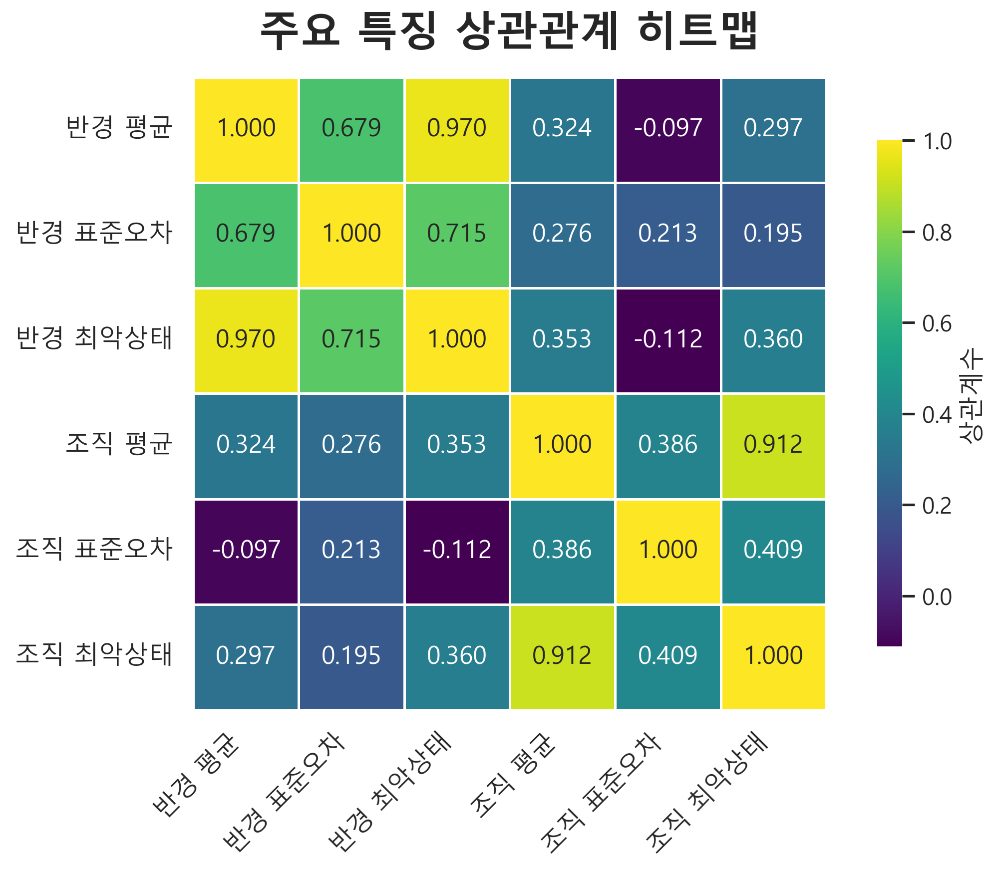

✅ 주요 특징 상관관계 히트맵 완료: 6개 특징 사용


In [60]:
# ============================================
# 시각화 1-2: 주요 특징 상관관계 히트맵
# ============================================
print("=" * 50)
print("시각화 1-2: 주요 특징 상관관계 히트맵")
print("=" * 50)

# 한글 폰트 재확인 및 적용 (한글 깨짐 방지)
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for f in korean_fonts:
    if f in font_list:
        selected_font = f
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# df_scaled 확인
ensure_df_scaled()

# 주요 특징 선택 (반경, 조직 관련 특징)
subset = ['반경 평균', '반경 표준오차', '반경 최악상태',
          '조직 평균', '조직 표준오차', '조직 최악상태']

# 실제 존재하는 컬럼만 선택
subset = [col for col in subset if col in df_scaled.columns]

if len(subset) > 0:
    plt.figure(figsize=(8, 6), dpi=300)
    sns.heatmap(
        df_scaled[subset].corr(), 
        cmap='viridis',  # 알록달록한 색상 팔레트 (보라-노랑 그라데이션)
        annot=True,
        fmt='.3f',
        square=True,
        linewidths=0.8,
        cbar_kws={"shrink": 0.8, "label": "상관계수"}
    )
    
    title = '주요 특징 상관관계 히트맵'
    if selected_font:
        plt.title(title, fontsize=20, fontweight='bold', fontfamily=selected_font, pad=15)
    else:
        plt.title(title, fontsize=20, fontweight='bold', pad=15)
    
    # 한글 폰트 명시적 적용 (xticks, yticks)
    if selected_font:
        plt.xticks(rotation=45, ha='right', fontsize=12, fontfamily=selected_font)
        plt.yticks(rotation=0, fontsize=12, fontfamily=selected_font)
    else:
        plt.xticks(rotation=45, ha='right', fontsize=12)
        plt.yticks(rotation=0, fontsize=12)
    
    plt.tight_layout()
    plt.show()
    
    print(f"✅ 주요 특징 상관관계 히트맵 완료: {len(subset)}개 특징 사용")
else:
    print("⚠️ 지정한 주요 특징이 데이터에 없습니다.")


시각화 2: 버블 차트


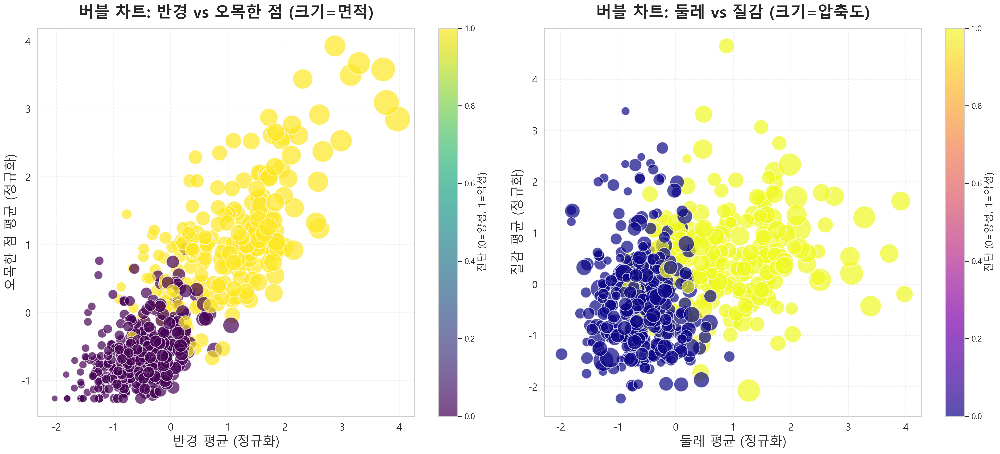

버블 차트 완료: 버블 크기는 세 번째 특징의 값을 나타냄


In [61]:
# ============================================
# 시각화 2: 버블 차트 (Bubble Chart)
# ============================================
print("=" * 50)
print("시각화 2: 버블 차트")
print("=" * 50)

# 한글 폰트 재확인 및 적용
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# 정규화된 데이터 사용 (고화질, 컬러풀)
fig, axes = plt.subplots(1, 2, figsize=(20, 9), dpi=300)

# 버블 차트 1: radius_mean vs concave points_mean (크기 = area_mean)
bubble_size1 = (df_scaled['면적 평균'] - df_scaled['면적 평균'].min()) / (
    df_scaled['면적 평균'].max() - df_scaled['면적 평균'].min()) * 1200 + 80

scatter1 = axes[0].scatter(
    df_scaled['반경 평균'], 
    df_scaled['오목한 포인트 개수 평균'],
    s=bubble_size1,
    c=df_scaled['진단'],
    cmap='viridis',  # 더 컬러풀한 컬러맵
    alpha=0.7,
    edgecolors='white',
    linewidth=1.0
)

# 한글 제목 및 라벨 설정
if selected_font:
    axes[0].set_title('버블 차트: 반경 vs 오목한 점 (크기=면적)', 
                     fontsize=22, fontweight='bold', fontfamily=selected_font, pad=15)
    axes[0].set_xlabel('반경 평균 (정규화)', fontsize=18, fontfamily=selected_font)
    axes[0].set_ylabel('오목한 점 평균 (정규화)', fontsize=18, fontfamily=selected_font)
else:
    axes[0].set_title('버블 차트: 반경 vs 오목한 점 (크기=면적)', fontsize=22, fontweight='bold', pad=15)
    axes[0].set_xlabel('반경 평균 (정규화)', fontsize=18)
    axes[0].set_ylabel('오목한 점 평균 (정규화)', fontsize=18)

axes[0].grid(True, alpha=0.3, linestyle='--')
axes[0].tick_params(labelsize=14)
cbar1 = plt.colorbar(scatter1, ax=axes[0])
if selected_font:
    cbar1.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    cbar1.set_label('진단 (0=양성, 1=악성)', fontsize=14)

# 버블 차트 2: perimeter_mean vs texture_mean (크기 = compactness_mean)
bubble_size2 = (df_scaled['치밀도 평균'] - df_scaled['치밀도 평균'].min()) / (
    df_scaled['치밀도 평균'].max() - df_scaled['치밀도 평균'].min()) * 1200 + 80

scatter2 = axes[1].scatter(
    df_scaled['둘레 길이 평균'],
    df_scaled['조직 평균'],
    s=bubble_size2,
    c=df_scaled['진단'],
    cmap='plasma',  # 더 컬러풀한 컬러맵
    alpha=0.7,
    edgecolors='white',
    linewidth=1.0
)

# 한글 제목 및 라벨 설정
if selected_font:
    axes[1].set_title('버블 차트: 둘레 vs 질감 (크기=압축도)', 
                     fontsize=22, fontweight='bold', fontfamily=selected_font, pad=15)
    axes[1].set_xlabel('둘레 평균 (정규화)', fontsize=18, fontfamily=selected_font)
    axes[1].set_ylabel('질감 평균 (정규화)', fontsize=18, fontfamily=selected_font)
else:
    axes[1].set_title('버블 차트: 둘레 vs 질감 (크기=압축도)', fontsize=22, fontweight='bold', pad=15)
    axes[1].set_xlabel('둘레 평균 (정규화)', fontsize=18)
    axes[1].set_ylabel('질감 평균 (정규화)', fontsize=18)

axes[1].grid(True, alpha=0.3, linestyle='--')
axes[1].tick_params(labelsize=14)
cbar2 = plt.colorbar(scatter2, ax=axes[1])
if selected_font:
    cbar2.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    cbar2.set_label('진단 (0=양성, 1=악성)', fontsize=14)

plt.tight_layout()
plt.show()

print("버블 차트 완료: 버블 크기는 세 번째 특징의 값을 나타냄")


시각화 3: 모자이크 플롯


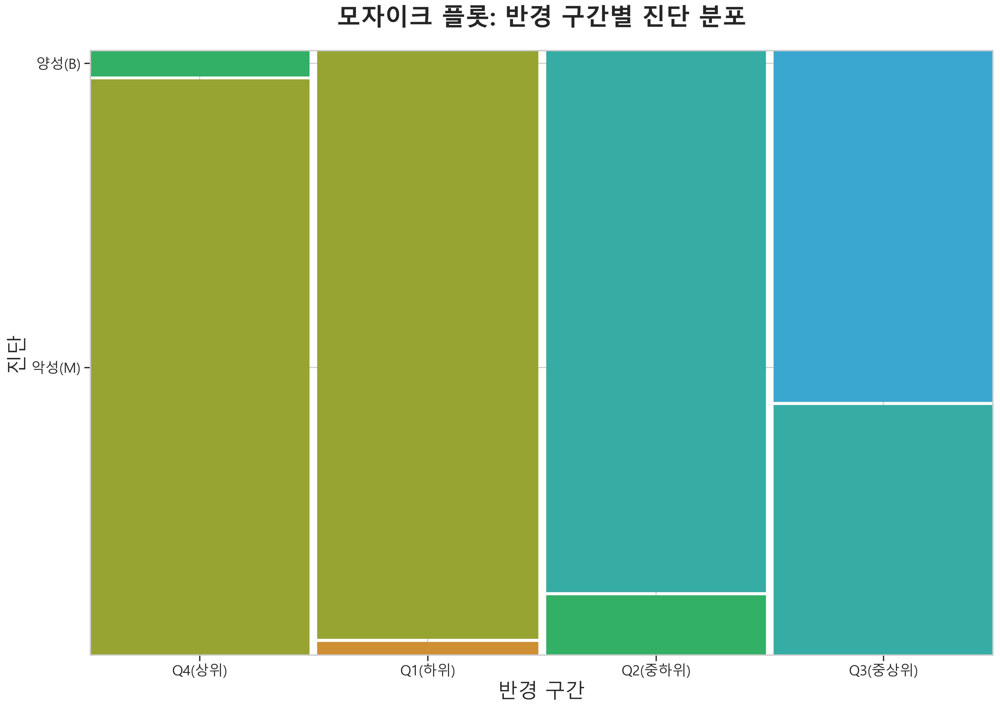


교차표:
진단              악성(M)      양성(B)
radius_bin                      
Q1(하위)       2.097902  97.902098
Q2(중하위)      9.859155  90.140845
Q3(중상위)     41.549296  58.450704
Q4(상위)      95.774648   4.225352


In [62]:
# ============================================
# 시각화 3: 모자이크 플롯 (Mosaic Plot)
# ============================================
print("=" * 50)
print("시각화 3: 모자이크 플롯")
print("=" * 50)

# 한글 폰트 재확인 및 적용
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# radius_mean을 4분위로 나누기
radius_bins = pd.qcut(df_scaled['반경 평균'], q=4, labels=['Q1(하위)', 'Q2(중하위)', 'Q3(중상위)', 'Q4(상위)'])
mosaic_data = pd.DataFrame({
    'radius_bin': radius_bins,
    '진단': df_scaled['진단'].map({0: '양성(B)', 1: '악성(M)'})
})

# 모자이크 플롯 생성 (고화질, 컬러풀)
fig, ax = plt.subplots(figsize=(14, 10), dpi=300)
mosaic(mosaic_data, ['radius_bin', '진단'], ax=ax, title='', 
       labelizer=lambda k: '', gap=0.01, 
       properties=lambda key: {'color': sns.color_palette("husl", 8)[hash(key) % 8]})

# 한글 제목 및 라벨 설정
if selected_font:
    ax.set_title('모자이크 플롯: 반경 구간별 진단 분포', 
                fontsize=24, fontweight='bold', pad=25, fontfamily=selected_font)
    ax.set_xlabel('반경 구간', fontsize=20, fontfamily=selected_font)
    ax.set_ylabel('진단', fontsize=20, fontfamily=selected_font)
else:
    ax.set_title('모자이크 플롯: 반경 구간별 진단 분포', fontsize=24, fontweight='bold', pad=25)
    ax.set_xlabel('반경 구간', fontsize=20)
    ax.set_ylabel('진단', fontsize=20)
ax.tick_params(labelsize=14)

plt.tight_layout()
plt.show()

# 교차표 출력
print("\n교차표:")
print(pd.crosstab(mosaic_data['radius_bin'], mosaic_data['진단'], normalize='index') * 100)


시각화 4: 레이더 차트


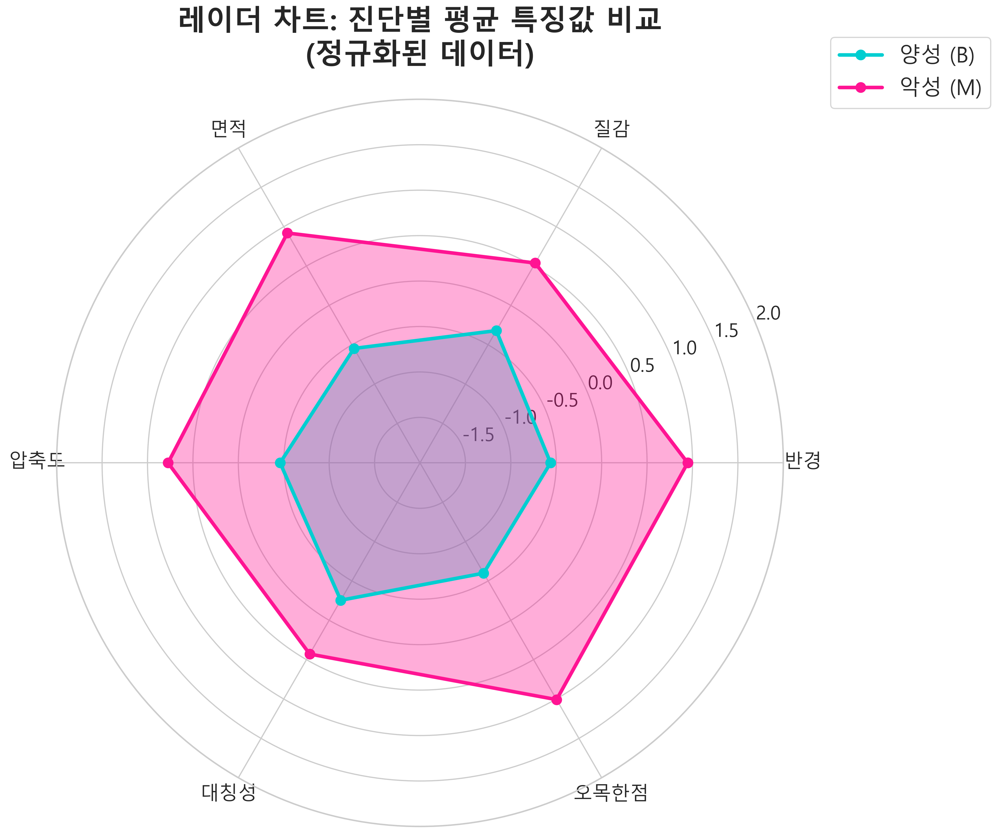

레이더 차트 완료: 양성과 악성의 특징 패턴 비교


In [63]:
# ============================================
# 시각화 4: 레이더 차트 (Radar Chart)
# ============================================
print("=" * 50)
print("시각화 4: 레이더 차트")
print("=" * 50)

# 한글 폰트 재확인 및 적용
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# 주요 특징 선택
radar_features = ['반경 평균', '조직 평균', '면적 평균', '치밀도 평균', '좌우 대칭도 평균', '오목한 포인트 개수 평균']
radar_data = df_scaled.groupby('진단')[radar_features].mean()

# 각도 계산
angles = np.linspace(0, 2 * np.pi, len(radar_features), endpoint=False)
angles = np.concatenate((angles, [angles[0]]))  # 닫힌 형태를 위해

# 레이더 차트 생성 (고화질, 컬러풀)
fig = plt.figure(figsize=(12, 12), dpi=300)
ax = fig.add_subplot(111, projection='polar')

# 더 컬러풀한 색상
colors = ['#00CED1', '#FF1493']  # 청록색과 핑크
labels_kr = ['반경', '질감', '면적', '압축도', '대칭성', '오목한점']

for idx, (diagnosis_value, row) in enumerate(radar_data.iterrows()):
    values = np.concatenate((row.values, [row.values[0]]))
    label = '악성 (M)' if diagnosis_value == 1 else '양성 (B)'
    ax.plot(angles, values, 'o-', linewidth=3, label=label, color=colors[idx], markersize=8)
    ax.fill(angles, values, alpha=0.35, color=colors[idx])

ax.set_xticks(angles[:-1])
if selected_font:
    ax.set_xticklabels(labels_kr, fontsize=20, fontfamily=selected_font)
else:
    ax.set_xticklabels(labels_kr, fontsize=20)

ax.set_ylim(-2, 2)
ax.tick_params(labelsize=16)

# 한글 제목 설정
if selected_font:
    ax.set_title('레이더 차트: 진단별 평균 특징값 비교\n(정규화된 데이터)', 
                 fontsize=24, fontweight='bold', pad=30, fontfamily=selected_font)
else:
    ax.set_title('레이더 차트: 진단별 평균 특징값 비교\n(정규화된 데이터)', 
                 fontsize=24, fontweight='bold', pad=30)

# 범례 설정
legend = ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=18)
if selected_font:
    for text in legend.get_texts():
        text.set_fontfamily(selected_font)

ax.grid(True)

plt.tight_layout()
plt.show()

print("레이더 차트 완료: 양성과 악성의 특징 패턴 비교")


사용하는 feature 개수: 30
예시 feature: ['반경 평균', '조직 평균', '둘레 길이 평균', '면적 평균', '매끄러움 평균']


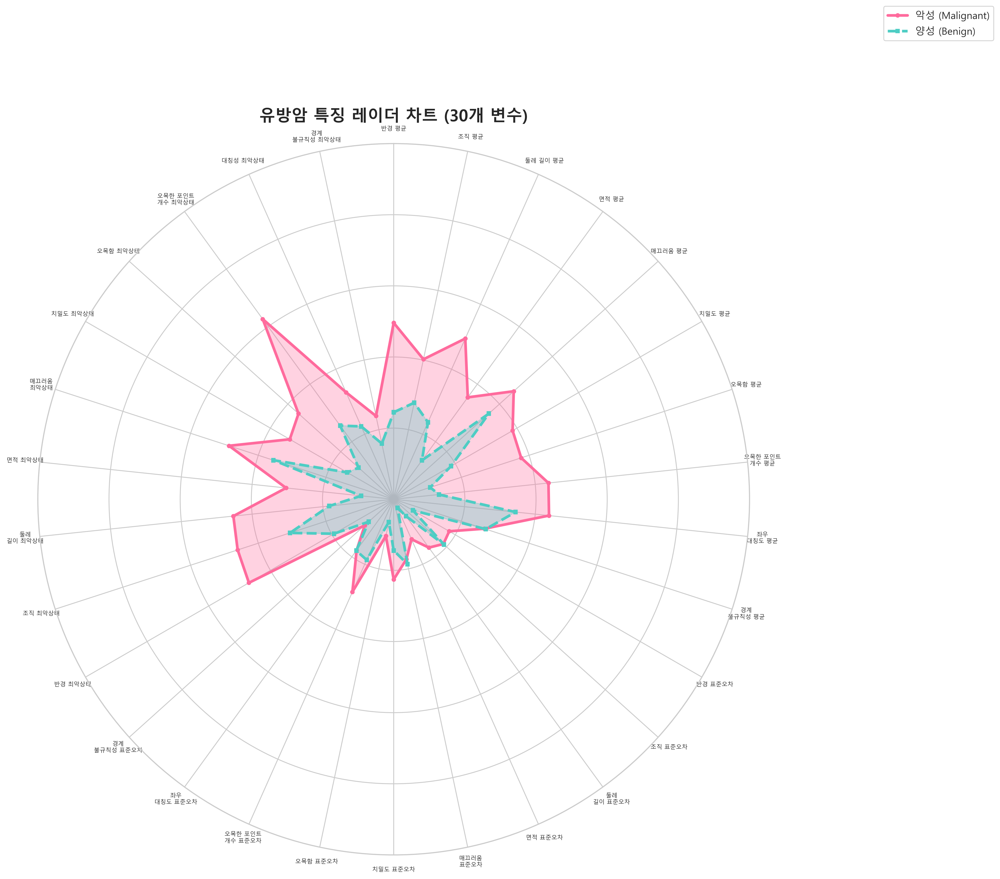

✅ 레이더 차트 완료: 30개 특징 사용


In [64]:
# 레이더차트 4-1
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import matplotlib.font_manager as fm

# 한글 폰트 설정 (한글 깨짐 방지)
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for f in korean_fonts:
    if f in font_list:
        selected_font = f
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# df가 없으면 데이터 로드
if 'df' not in globals():
    try:
        df = pd.read_csv("kr_data.csv")
        print("✅ kr_data.csv 로드 완료")
    except:
        print("⚠️ df 변수가 없고 데이터 파일도 찾을 수 없습니다.")

# 타겟 컬럼 확인 (한글/영문 모두 지원)
if "진단" in df.columns:
    target_col = "진단"
elif "Diagnosis" in df.columns:
    target_col = "Diagnosis"
else:
    raise ValueError("'진단' 또는 'Diagnosis' 컬럼을 찾을 수 없습니다.")

# --------------------------
# 1-1. M/B → 1/0 매핑 (이미 했으면 이 부분은 건너뛰어도 됨)
# --------------------------
if df[target_col].dtype == "object":   # 아직 문자열이면
    df[target_col] = df[target_col].map({"M": 1, "B": 0, "악성(M)": 1, "양성(B)": 0, "악성": 1, "양성": 0})

# ==========================
# 2. feature 선택
#    (id/ID, 진단/Diagnosis 제외)
# ==========================
feature_cols = [c for c in df.columns if c not in ["id", "ID", target_col, "Unnamed: 32"]]
print(f"사용하는 feature 개수: {len(feature_cols)}")
print(f"예시 feature: {feature_cols[:5]}")

# ==========================
# 3. Min-Max 스케일링 (0~1)
# ==========================
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(df[feature_cols])

df_scaled_radar = pd.DataFrame(scaled_features, columns=feature_cols)
df_scaled_radar[target_col] = df[target_col]

# ==========================
# 4. 진단별 평균값 계산 (1=Malignant, 0=Benign)
# ==========================
mean_m = df_scaled_radar[df_scaled_radar[target_col] == 1][feature_cols].mean()
mean_b = df_scaled_radar[df_scaled_radar[target_col] == 0][feature_cols].mean()

values_m = mean_m.values
values_b = mean_b.values

# ==========================
# 5. 레이더 차트 설정
# ==========================
N = len(feature_cols)
angles = np.linspace(0, 2 * np.pi, N, endpoint=False)

# 폐곡선 만들기 위해 첫 값 다시 뒤에 붙이기
values_m = np.concatenate((values_m, [values_m[0]]))
values_b = np.concatenate((values_b, [values_b[0]]))
angles = np.concatenate((angles, [angles[0]]))

# 그래프 크기를 키워서 레이블 공간 확보
plt.figure(figsize=(16, 16), dpi=300)
ax = plt.subplot(111, polar=True)

# 알록달록한 색상 적용
color_m = '#FF6B9D'  # 핑크/빨강 계열
color_b = '#4ECDC4'  # 청록/파랑 계열

ax.plot(angles, values_m, linewidth=3, label="악성 (Malignant)", color=color_m, marker='o', markersize=4)
ax.fill(angles, values_m, alpha=0.3, color=color_m)

ax.plot(angles, values_b, linewidth=3, linestyle="--", label="양성 (Benign)", color=color_b, marker='s', markersize=4)
ax.fill(angles, values_b, alpha=0.3, color=color_b)

# x축 레이블: 변수 이름 (한글 폰트 적용, 겹침 방지)
ax.set_xticks(angles[:-1])

# 레이블을 짧게 만들기 (공백 제거, 길이 제한)
short_labels = []
for label in feature_cols:
    # 너무 긴 레이블은 줄바꿈 또는 축약
    if len(label) > 8:
        # 공백 기준으로 줄바꿈 시도
        words = label.split()
        if len(words) > 1:
            # 두 단어면 중간에 줄바꿈
            mid = len(words) // 2
            short_label = '\n'.join([' '.join(words[:mid]), ' '.join(words[mid:])])
        else:
            # 한 단어면 그대로 (너무 길면 축약)
            short_label = label[:10] + '...' if len(label) > 10 else label
    else:
        short_label = label
    short_labels.append(short_label)

# 레이블 설정 (폰트 크기 줄이고, 겹침 방지)
if selected_font:
    labels = ax.set_xticklabels(short_labels, fontsize=6.5, fontfamily=selected_font)
else:
    labels = ax.set_xticklabels(short_labels, fontsize=6.5)

# 레이블 위치 조정 (겹침 방지) - polar plot용
# 레이블을 바깥쪽으로 이동하여 겹침 방지
for label in labels:
    label.set_horizontalalignment('center')
    label.set_verticalalignment('center')
    # 레이블을 더 바깥쪽으로 이동
    x, y = label.get_position()
    # polar plot에서는 반지름을 증가시켜 바깥쪽으로 이동
    if hasattr(label, 'set_position'):
        # 레이블 위치를 조정 (각도는 유지, 반지름만 증가)
        label.set_position((x, y * 1.2))  # 20% 더 바깥쪽

# y축 (0~1)
ax.set_ylim(0, 1)
ax.set_yticklabels([])
ax.set_theta_zero_location('N')  # 0도를 위쪽으로
ax.set_theta_direction(-1)  # 시계 방향

# 제목 (한글 폰트 적용)
title = f"유방암 특징 레이더 차트 ({len(feature_cols)}개 변수)"
if selected_font:
    plt.title(title, fontsize=18, fontweight='bold', fontfamily=selected_font, pad=25)
else:
    plt.title(title, fontsize=18, fontweight='bold', pad=25)

# 범례 (한글 폰트 적용)
if selected_font:
    plt.legend(loc="upper right", bbox_to_anchor=(1.35, 1.2), fontsize=12, prop={'family': selected_font})
else:
    plt.legend(loc="upper right", bbox_to_anchor=(1.35, 1.2), fontsize=12)

plt.tight_layout()
plt.show()
print(f"✅ 레이더 차트 완료: {len(feature_cols)}개 특징 사용")


시각화 5: Pairplot (3개 그래프)
전체 Pairplot 특징: ['반경 평균', '조직 평균', '면적 평균', '치밀도 평균', '좌우 대칭도 평균', '오목한 포인트 개수 평균', '둘레 길이 평균', '매끄러움 평균', '오목함 평균']

총 3개의 Pairplot 그래프를 생성합니다.
  그래프 1: ['반경 평균', '조직 평균', '면적 평균']
  그래프 2: ['치밀도 평균', '좌우 대칭도 평균', '오목한 포인트 개수 평균']
  그래프 3: ['둘레 길이 평균', '매끄러움 평균', '오목함 평균']

Pairplot 생성 중... (시간이 걸릴 수 있습니다)

[그래프 1/3] 생성 중: ['반경 평균', '조직 평균', '면적 평균']


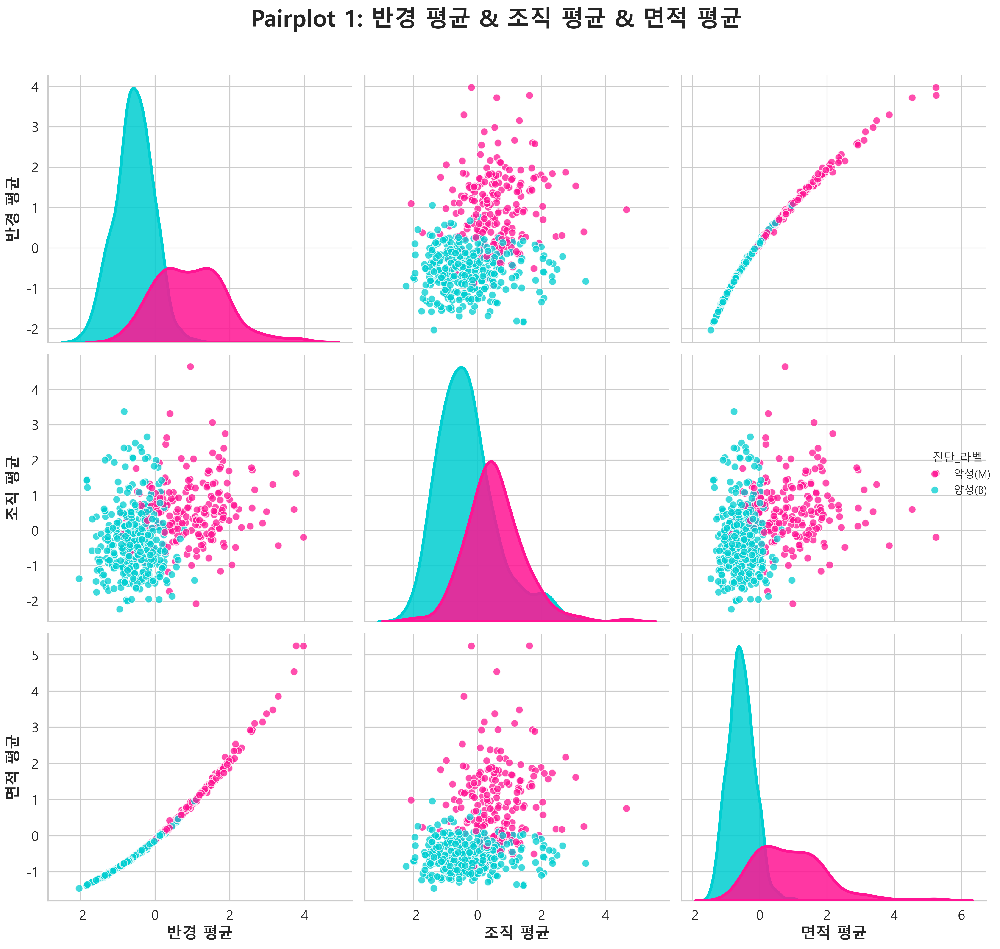

  ✅ 그래프 1 완료

[그래프 2/3] 생성 중: ['치밀도 평균', '좌우 대칭도 평균', '오목한 포인트 개수 평균']


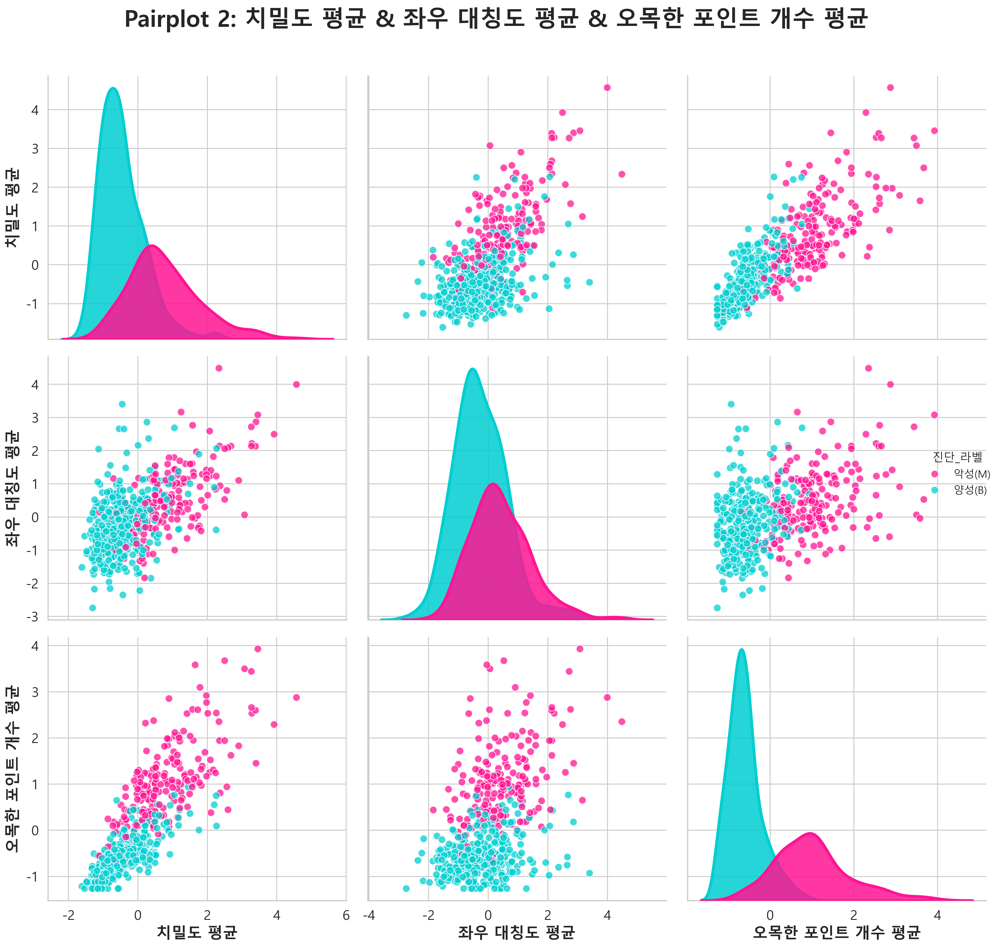

  ✅ 그래프 2 완료

[그래프 3/3] 생성 중: ['둘레 길이 평균', '매끄러움 평균', '오목함 평균']


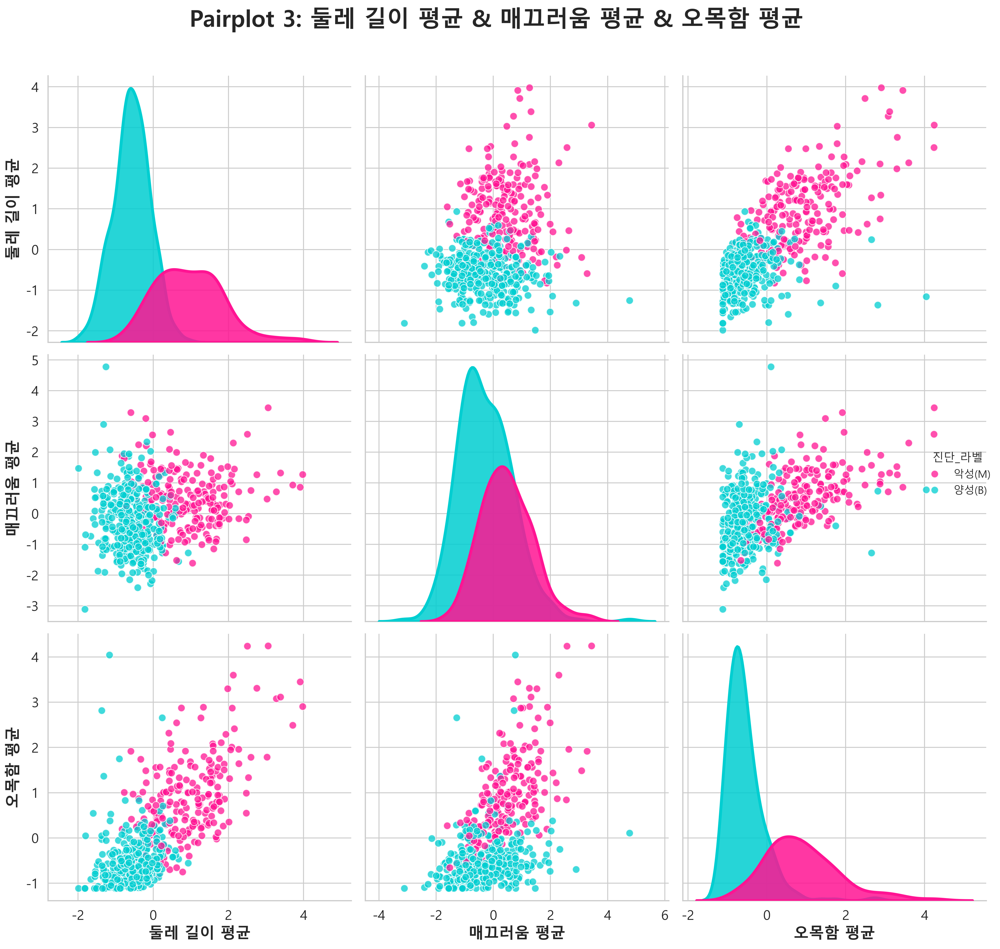

  ✅ 그래프 3 완료

✅ 총 3개의 Pairplot 완료: 주요 특징 간 관계를 그룹별로 확인할 수 있습니다.


In [65]:
# ============================================
# 시각화 5: Pairplot (고화질, 컬러풀) - 3개 그래프 생성
# ============================================
print("=" * 50)
print("시각화 5: Pairplot (3개 그래프)")
print("=" * 50)

# df_scaled 확인
ensure_df_scaled()

# 주요 특징 선택 (9개로 확장하여 3개씩 나눔)
all_pairplot_features = [
    '반경 평균',
    '조직 평균',
    '면적 평균',
    '치밀도 평균',
    '좌우 대칭도 평균',
    '오목한 포인트 개수 평균',
    '둘레 길이 평균',
    '매끄러움 평균',
    '오목함 평균'
]

# 존재하는 특징만 선택
all_pairplot_features = [f for f in all_pairplot_features if f in df_scaled.columns]
print(f"전체 Pairplot 특징: {all_pairplot_features}")

# 3개 그룹으로 나누기 (각 그래프당 3개 특징)
n_features = len(all_pairplot_features)
features_per_plot = 3
n_plots = 3

# 특징을 3개 그룹으로 분할
feature_groups = []
for i in range(n_plots):
    start_idx = i * features_per_plot
    end_idx = min(start_idx + features_per_plot, n_features)
    if start_idx < n_features:
        feature_groups.append(all_pairplot_features[start_idx:end_idx])

print(f"\n총 {len(feature_groups)}개의 Pairplot 그래프를 생성합니다.")
for idx, group in enumerate(feature_groups, 1):
    print(f"  그래프 {idx}: {group}")

# Pairplot용 데이터 준비
df_pairplot = df_scaled[all_pairplot_features + ['진단']].copy()
df_pairplot['진단_라벨'] = df_pairplot['진단'].map({0: '양성(B)', 1: '악성(M)'})

# 각 그룹별로 Pairplot 생성
print("\nPairplot 생성 중... (시간이 걸릴 수 있습니다)")

for plot_idx, feature_group in enumerate(feature_groups, 1):
    print(f"\n[그래프 {plot_idx}/{len(feature_groups)}] 생성 중: {feature_group}")
    
    g = sns.pairplot(
        df_pairplot,
        vars=feature_group,
        hue='진단_라벨',
        palette={'양성(B)': '#00CED1', '악성(M)': '#FF1493'},  # 생생한 색상
        diag_kind='kde',  # 대각선: 커널 밀도 추정
        plot_kws={'s': 60, 'alpha': 0.75, 'edgecolors': 'white', 'linewidth': 0.8},
        diag_kws={'alpha': 0.85, 'linewidth': 3, 'shade': True},
        height=4.5,  # 높이 증가
        aspect=1
    )
    
    # 모든 subplot의 폰트 크기 조정
    for ax in g.axes.flat:
        if ax is not None:
            ax.tick_params(labelsize=14)  # 눈금 폰트 크기
            
            # xlabel과 ylabel 설정
            xlabel_text = ax.get_xlabel()
            ylabel_text = ax.get_ylabel()
            
            if xlabel_text:
                if selected_font:
                    ax.set_xlabel(xlabel_text, fontsize=16, fontfamily=selected_font, 
                                fontweight='bold')
                else:
                    ax.set_xlabel(xlabel_text, fontsize=16, fontweight='bold')
            
            if ylabel_text:
                if selected_font:
                    ax.set_ylabel(ylabel_text, fontsize=16, fontfamily=selected_font, 
                                fontweight='bold')
                else:
                    ax.set_ylabel(ylabel_text, fontsize=16, fontweight='bold')
            
            # 범례 폰트 크기 조정 및 스타일 개선
            legend = ax.get_legend()
            if legend is not None:
                # 범례 프레임 스타일 개선
                legend.get_frame().set_facecolor('white')
                legend.get_frame().set_alpha(0.9)
                legend.get_frame().set_edgecolor('black')
                legend.get_frame().set_linewidth(2)
                legend.get_frame().set_boxstyle('round,pad=0.5')
                
                if selected_font:
                    for text in legend.get_texts():
                        text.set_fontsize(14)
                        text.set_fontfamily(selected_font)
                        text.set_fontweight('bold')
                else:
                    for text in legend.get_texts():
                        text.set_fontsize(14)
                        text.set_fontweight('bold')
    
    # 제목 추가 (더 크게)
    title = f'Pairplot {plot_idx}: {" & ".join(feature_group)}'
    if selected_font:
        g.fig.suptitle(title, 
                       fontsize=24, fontweight='bold', y=1.02, fontfamily=selected_font)
    else:
        g.fig.suptitle(title, 
                       fontsize=24, fontweight='bold', y=1.02)
    
    plt.tight_layout()
    plt.show()
    
    print(f"  ✅ 그래프 {plot_idx} 완료")

print(f"\n✅ 총 {len(feature_groups)}개의 Pairplot 완료: 주요 특징 간 관계를 그룹별로 확인할 수 있습니다.")


Windows 환경: 기본/설치된 한글 폰트 사용
Matplotlib 폰트 설정 완료 (Windows): Malgun Gothic
시각화(평균 10개): 바이올린 차트 준비
선택된 '평균' feature 목록:
 - 반경 평균
 - 조직 평균
 - 둘레 길이 평균
 - 면적 평균
 - 매끄러움 평균
 - 치밀도 평균
 - 오목함 평균
 - 오목한 포인트 개수 평균
 - 좌우 대칭도 평균
 - 경계 불규칙성 평균
시각화: 바이올린 차트 (10가지 '평균' 특징)


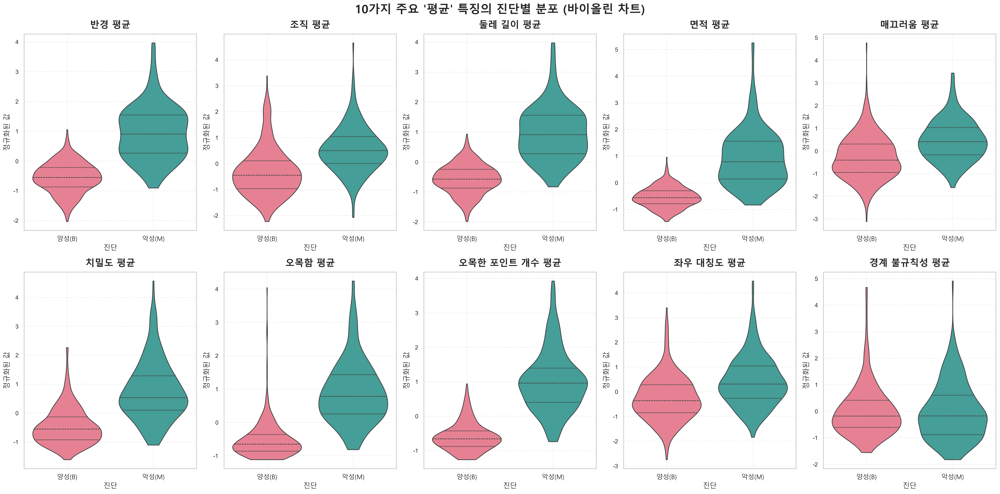

✅ 바이올린 차트 완료: 10개 '평균' 특징의 분포 차이를 시각적으로 확인했습니다.


In [66]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler
import matplotlib.font_manager as fm
import os
import platform
import subprocess

# ============================================
# 0. 한글 폰트 설정 (Windows / Colab 공통)
# ============================================

if platform.system() != 'Windows':
    # Linux / Colab 환경
    try:
        subprocess.run(['apt-get', 'update', '-qq'], check=False, capture_output=True, timeout=10)
        subprocess.run(
            ['apt-get', 'install', 'fonts-nanum', '-qq'],
            check=False,
            capture_output=True,
            stdout=subprocess.DEVNULL,
            stderr=subprocess.DEVNULL,
            timeout=30
        )
        subprocess.run(['rm', '-rf', os.path.expanduser('~/.cache/matplotlib')],
                       check=False, capture_output=True)

        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'
        if os.path.exists(font_path):
            fm.fontManager.addfont(font_path)
            font_name = fm.FontProperties(fname=font_path).get_name()
            plt.rc('font', family=font_name)
            plt.rcParams['axes.unicode_minus'] = False
            print(f"Matplotlib 폰트 설정 완료 (Linux): {font_name}")
        else:
            print("폰트 경로를 찾을 수 없습니다. 기본 폰트로 실행합니다.")
    except Exception as e:
        print(f"폰트 설치 명령 실행 중 오류 발생 (기존 폰트 설정 사용): {str(e)}")
else:
    # Windows 환경
    print("Windows 환경: 기본/설치된 한글 폰트 사용")
    candidate_fonts = ['Malgun Gothic', '맑은 고딕', 'NanumGothic', '나눔고딕']
    available = set(f.name for f in fm.fontManager.ttflist)

    chosen = None
    for f_name in candidate_fonts:
        if f_name in available:
            chosen = f_name
            break

    if chosen is not None:
        plt.rc('font', family=chosen)
        plt.rcParams['axes.unicode_minus'] = False
        print(f"Matplotlib 폰트 설정 완료 (Windows): {chosen}")
    else:
        print("적절한 한글 폰트를 찾지 못했습니다. 기본 폰트로 진행합니다.")

# selected_font 변수가 앞에서 정의되지 않았다면 None으로 처리
try:
    selected_font
except NameError:
    selected_font = None

# ============================================
# 1. 진단/특징 컬럼 정리 & 평균 특징 선택
# ============================================

print("=" * 50)
print("시각화(평균 10개): 바이올린 차트 준비")
print("=" * 50)

# 진단 컬럼 이름이 '진단'이라고 가정 ('B', 'M')
if '진단' not in df.columns:
    raise KeyError("⚠️ df에 '진단' 컬럼이 없습니다. 진단 컬럼 이름을 확인하세요.")

# 수치형 컬럼 목록
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns.tolist()

# 제외할 컬럼들 (id, 진단 등)
exclude_cols = ['id', '진단', 'Diagnosis', 'Diagnosis_label', 'Diagnosis_num']
feature_cols = [col for col in numeric_cols if col not in exclude_cols]

# '평균' 이라는 단어가 들어가는 특징들만 선택 (10개)
mean_features = [col for col in feature_cols if '평균' in col]

print("선택된 '평균' feature 목록:")
for f in mean_features:
    print(" -", f)

# ============================================
# 2. StandardScaler로 평균 특징만 정규화
# ============================================

scaler = StandardScaler()
scaled_values = scaler.fit_transform(df[mean_features])

df_scaled = pd.DataFrame(scaled_values, columns=mean_features)

# 진단 컬럼 추가 (B/M 그대로 사용)
df_scaled['진단'] = df['진단'].values

# ============================================
# 3. 바이올린 플롯 (평균 특징 10개)
# ============================================

print("=" * 50)
print("시각화: 바이올린 차트 (10가지 '평균' 특징)")
print("=" * 50)

sns.set(style="whitegrid")

n_features = len(mean_features)
rows, cols = 2, 5   # 10개 기준
fig, axes = plt.subplots(rows, cols, figsize=(24, 12), dpi=300)
axes_flat = axes.flatten()

# 컬러풀한 팔레트 (양성/악성 2색)
palette_colors = sns.color_palette("husl", 2)

for ax, feature in zip(axes_flat, mean_features):
    sns.violinplot(
        data=df_scaled,
        x='진단',       # B / M
        y=feature,
        ax=ax,
        inner='quartile',   # 사분위수 표시
        cut=0,              # 꼬리 과도하게 안 그리게
        palette=palette_colors  # 컬러풀한 팔레트 (⚠ hue 없이 palette만, 시각화6과 동일 스타일)
    )

    if selected_font:
        ax.set_title(f'{feature}', fontsize=16, fontweight='bold',
                     fontfamily=selected_font, pad=10)
        ax.set_xlabel('진단', fontsize=12, fontfamily=selected_font)
        ax.set_ylabel('정규화된 값', fontsize=12, fontfamily=selected_font)
    else:
        ax.set_title(f'{feature}', fontsize=16, fontweight='bold', pad=10)
        ax.set_xlabel('진단', fontsize=12)
        ax.set_ylabel('정규화된 값', fontsize=12)

    # X축 눈금 위치 & 레이블 고정 (양성/악성 순서)
    ticks = ax.get_xticks()  # 보통 [0, 1]
    ax.set_xticks(ticks)
    if selected_font:
        ax.set_xticklabels(['양성(B)', '악성(M)'], fontsize=11, fontfamily=selected_font)
    else:
        ax.set_xticklabels(['양성(B)', '악성(M)'], fontsize=11)

    ax.tick_params(axis='y', labelsize=10)
    ax.grid(True, alpha=0.3, linestyle='--')

# 만약 평균 feature가 10개보다 적으면 남는 subplot 숨기기
for j in range(len(mean_features), len(axes_flat)):
    axes_flat[j].axis('off')

if selected_font:
    plt.suptitle(
        "10가지 주요 '평균' 특징의 진단별 분포 (바이올린 차트)",
        fontsize=20, fontweight='bold', y=0.98, fontfamily=selected_font
    )
else:
    plt.suptitle(
        "10가지 주요 '평균' 특징의 진단별 분포 (바이올린 차트)",
        fontsize=20, fontweight='bold', y=0.98
    )

plt.tight_layout()
plt.show()

print("✅ 바이올린 차트 완료: 10개 '평균' 특징의 분포 차이를 시각적으로 확인했습니다.")


시각화 6: 바이올린 차트
바이올린 플롯에 사용할 특징: ['반경 평균', '조직 평균', '치밀도 평균', '좌우 대칭도 평균', '오목한 포인트 개수 평균', '면적 평균']


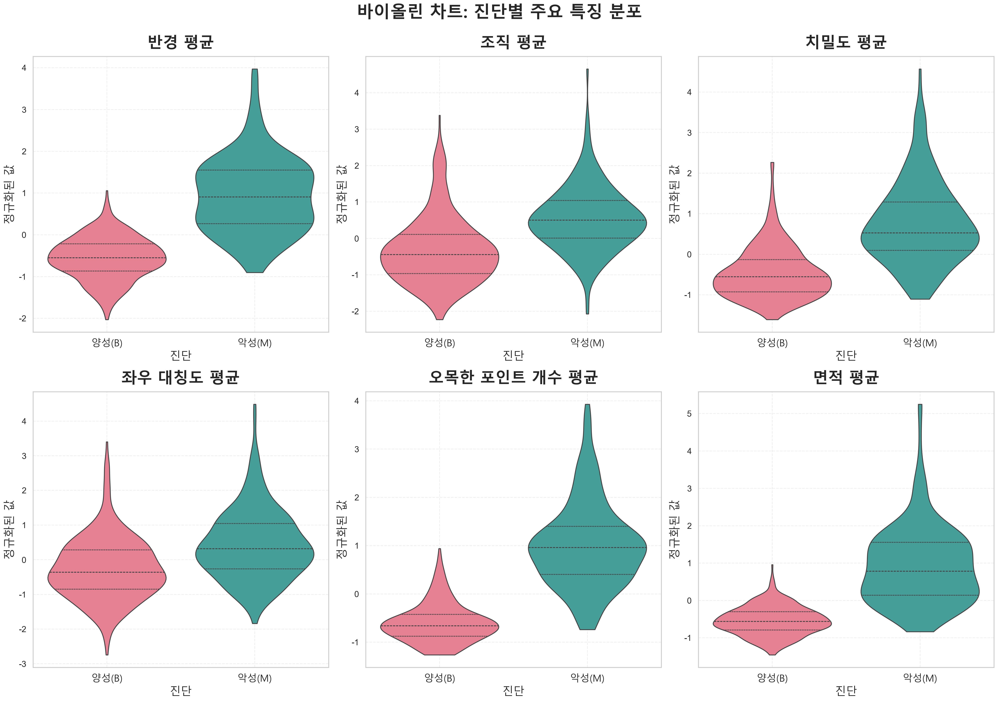

✅ 바이올린 차트 완료: 분포의 형태(폭)와 밀도(두께)를 동시에 확인할 수 있습니다.


In [67]:
# ============================================
# 시각화 6: 바이올린 차트 (Violin Plot)
# ============================================
print("=" * 50)
print("시각화 6: 바이올린 차트")
print("=" * 50)

# df_scaled가 이미 있고, diagnosis / 관심 특징들이 포함되어 있다고 가정
# (위에서 StandardScaler로 만든 df_scaled 사용)

# 주요 특징 선택
violin_features = [
    '반경 평균',
    '조직 평균',
    '치밀도 평균',
    '좌우 대칭도 평균',
    '오목한 포인트 개수 평균',  # 원본 컬럼명이 이게 맞음 (공백 있음)
    '면적 평균'
]

# 실제 df_scaled에 존재하는 컬럼만 사용 (오타 방지용)
violin_features = [f for f in violin_features if f in df_scaled.columns]
print("바이올린 플롯에 사용할 특징:", violin_features)

n_features = len(violin_features)
rows, cols = 2, 3

fig, axes = plt.subplots(rows, cols, figsize=(20, 14), dpi=300)

# 컬러풀한 팔레트
palette_colors = sns.color_palette("husl", 2)

# axes를 1차원 리스트로 펼치기
axes_flat = axes.flatten()

for ax, feature in zip(axes_flat, violin_features):
    sns.violinplot(
        data=df_scaled,
        x='진단',
        y=feature,
        ax=ax,
        inner='quartile',   # 사분위수 표시
        cut=0,              # 분포 꼬리 과도하게 그리지 않도록
        palette=palette_colors  # 컬러풀한 색상
    )
    
    if selected_font:
        ax.set_title(f'{feature}', fontsize=22, fontweight='bold', fontfamily=selected_font, pad=12)
        ax.set_xlabel('진단', fontsize=16, fontfamily=selected_font)
        ax.set_ylabel('정규화된 값', fontsize=16, fontfamily=selected_font)
    else:
        ax.set_title(f'{feature}', fontsize=22, fontweight='bold', pad=12)
        ax.set_xlabel('진단', fontsize=16)
        ax.set_ylabel('정규화된 값', fontsize=16)
    
    # X축 눈금 위치와 레이블을 같이 지정 → UserWarning 방지
    ticks = ax.get_xticks()  # 보통 [0, 1]
    ax.set_xticks(ticks)
    if selected_font:
        ax.set_xticklabels(['양성(B)', '악성(M)'], fontsize=14, fontfamily=selected_font)
    else:
        ax.set_xticklabels(['양성(B)', '악성(M)'], fontsize=14)
    ax.tick_params(axis='y', labelsize=12)
    
    ax.grid(True, alpha=0.3, linestyle='--')

# 만약 특징 개수가 6개보다 적어서 빈 subplot이 생기면 숨기기
for j in range(len(violin_features), len(axes_flat)):
    axes_flat[j].axis('off')

if selected_font:
    plt.suptitle('바이올린 차트: 진단별 주요 특징 분포', fontsize=24, fontweight='bold', y=0.995, fontfamily=selected_font)
else:
    plt.suptitle('바이올린 차트: 진단별 주요 특징 분포', fontsize=24, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

print("✅ 바이올린 차트 완료: 분포의 형태(폭)와 밀도(두께)를 동시에 확인할 수 있습니다.")



1. PCA (Principal Component Analysis)
기존 X_vis, y_vis 사용

PCA 계산 중...
PCA 2D 설명 분산 비율: [0.43555146 0.19277015]
PCA 2D 누적 설명 분산: 0.6283
PCA 3D 설명 분산 비율: [0.43555146 0.19277015 0.09361779]
PCA 3D 누적 설명 분산: 0.7219


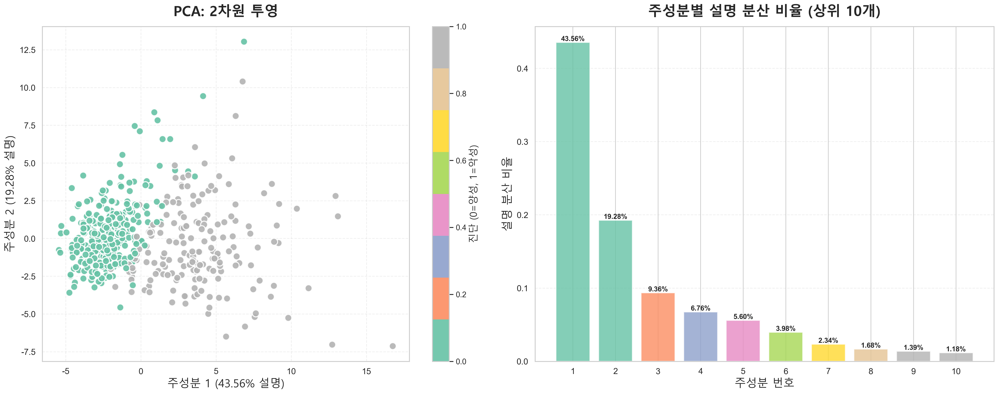

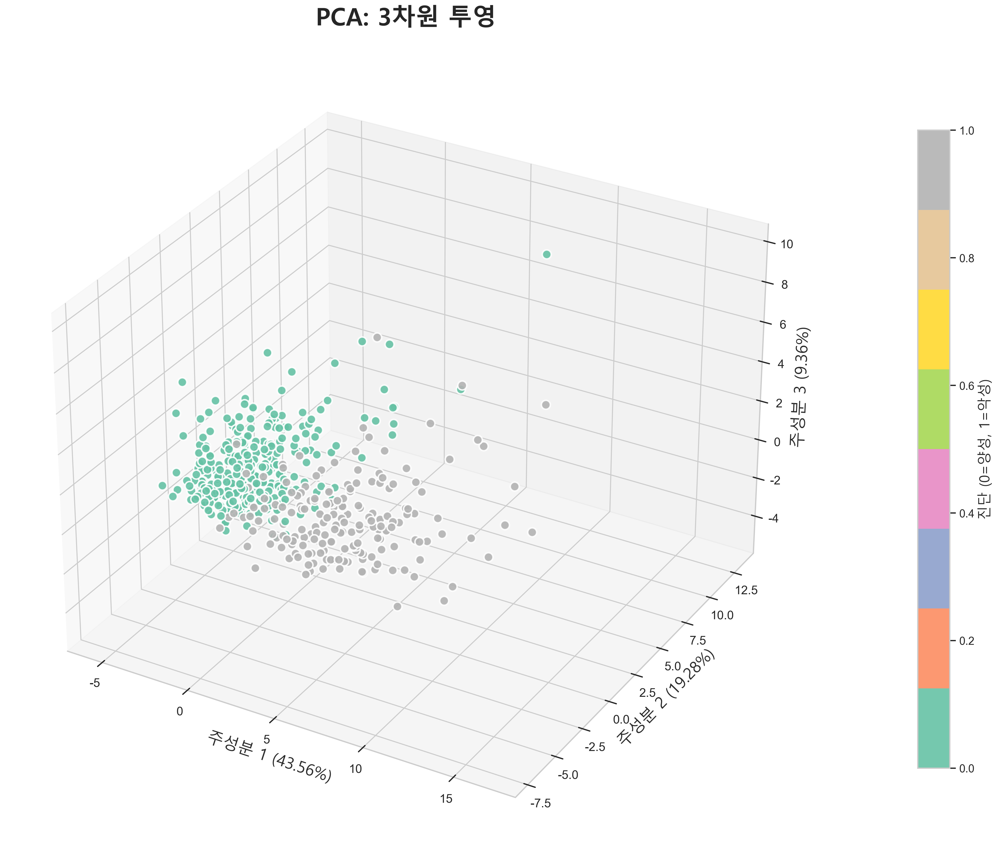


PCA 인터랙티브 3D 시각화 생성 중...
✅ PCA 인터랙티브 3D 그래프가 'pca_3d_interactive.html' 파일로 저장되었습니다!
   파일 경로: c:\Users\angel\OneDrive\Documents\breast\pca_3d_interactive.html
노트북 내 표시 중 오류 발생 (HTML 저장은 정상): Mime type rendering requires nbformat>=4.2.0 but it is not installed

✅ PCA 완료!


In [68]:
# ============================================
# 시각화7: PCA (Principal Component Analysis)
# ============================================
print("\n" + "=" * 70)
print("1. PCA (Principal Component Analysis)")
print("=" * 70)

from sklearn.decomposition import PCA
import numpy as np
import plotly.graph_objects as go
import os

# 데이터 준비 (X_vis가 없으면 생성)
try:
    # X_vis가 이미 정의되어 있는지 확인
    _ = X_vis
    _ = y_vis
    print("기존 X_vis, y_vis 사용")
except NameError:
    print("데이터 준비 중...")
    try:
        ensure_df_scaled()
    except:
        # ensure_df_scaled가 실패하면 직접 데이터 로드
        import pandas as pd
        from sklearn.preprocessing import StandardScaler
        
        if 'df' not in globals():
            df = pd.read_csv("kr_data.csv")
        
        # 진단 인코딩
        if df['진단'].dtype == 'object':
            df['진단'] = df['진단'].map({'M': 1, 'B': 0})
        
        # 특징 선택
        feature_cols_vis = [col for col in df.columns if col not in ['id', '진단', 'Unnamed: 32']]
        
        # 스케일링
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(df[feature_cols_vis])
        df_scaled = pd.DataFrame(X_scaled, columns=feature_cols_vis)
        df_scaled['진단'] = df['진단'].values
    
    # 특징과 타겟 분리
    feature_cols_vis = [col for col in df_scaled.columns if col != '진단']
    X_vis = df_scaled[feature_cols_vis].values
    y_vis = df_scaled['진단'].values
    
    # 샘플링 (너무 많으면 계산 시간이 오래 걸림)
    sample_size = min(500, len(X_vis))
    if len(X_vis) > sample_size:
        sample_idx = np.random.choice(len(X_vis), sample_size, replace=False)
        X_vis = X_vis[sample_idx]
        y_vis = y_vis[sample_idx]
        print(f"샘플링: {sample_size}개 샘플 사용")
    else:
        print(f"전체 {len(X_vis)}개 샘플 사용")
    
    print(f"데이터 shape: {X_vis.shape}")
    print(f"타겟 분포: 양성(B)={np.sum(y_vis==0)}, 악성(M)={np.sum(y_vis==1)}")

# PCA 계산 (2D, 3D)
print("\nPCA 계산 중...")
pca_2d = PCA(n_components=2, random_state=42)
X_pca_2d = pca_2d.fit_transform(X_vis)

pca_3d = PCA(n_components=3, random_state=42)
X_pca_3d = pca_3d.fit_transform(X_vis)

print(f"PCA 2D 설명 분산 비율: {pca_2d.explained_variance_ratio_}")
print(f"PCA 2D 누적 설명 분산: {pca_2d.explained_variance_ratio_.sum():.4f}")
print(f"PCA 3D 설명 분산 비율: {pca_3d.explained_variance_ratio_}")
print(f"PCA 3D 누적 설명 분산: {pca_3d.explained_variance_ratio_.sum():.4f}")

# ========== PCA 2D 시각화 (컬러풀 버전) ==========
fig, axes = plt.subplots(1, 2, figsize=(20, 8), dpi=300)

# 왼쪽: PCA 2D 투영 (쨍한 파스텔 톤 컬러바 사용)
scatter = axes[0].scatter(X_pca_2d[:, 0], X_pca_2d[:, 1], 
                         c=y_vis, cmap='Set2', s=100, alpha=0.9, 
                         edgecolors='white', linewidth=1.5)
cbar = plt.colorbar(scatter, ax=axes[0])
if selected_font:
    axes[0].set_xlabel(f'주성분 1 ({pca_2d.explained_variance_ratio_[0]:.2%} 설명)', 
                       fontsize=16, fontfamily=selected_font)
    axes[0].set_ylabel(f'주성분 2 ({pca_2d.explained_variance_ratio_[1]:.2%} 설명)', 
                       fontsize=16, fontfamily=selected_font)
    axes[0].set_title('PCA: 2차원 투영', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    axes[0].set_xlabel(f'주성분 1 ({pca_2d.explained_variance_ratio_[0]:.2%} 설명)', fontsize=16)
    axes[0].set_ylabel(f'주성분 2 ({pca_2d.explained_variance_ratio_[1]:.2%} 설명)', fontsize=16)
    axes[0].set_title('PCA: 2차원 투영', fontsize=20, fontweight='bold', pad=15)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14)
axes[0].grid(True, alpha=0.3, linestyle='--')
axes[0].tick_params(labelsize=12)

# 오른쪽: 주성분별 설명 분산 비율 (상위 10개)
pca_10d = PCA(n_components=10, random_state=42)
pca_10d.fit(X_vis)
explained_var = pca_10d.explained_variance_ratio_[:10]
colors_bar = plt.cm.Set2(np.linspace(0, 1, len(explained_var)))
bars = axes[1].bar(range(1, len(explained_var) + 1), explained_var, color=colors_bar, alpha=0.8, edgecolor='white', linewidth=1.5)
axes[1].set_xlabel('주성분 번호', fontsize=16, fontfamily=selected_font if selected_font else 'sans-serif')
axes[1].set_ylabel('설명 분산 비율', fontsize=16, fontfamily=selected_font if selected_font else 'sans-serif')
axes[1].set_title('주성분별 설명 분산 비율 (상위 10개)', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font if selected_font else 'sans-serif')
axes[1].set_xticks(range(1, len(explained_var) + 1))
axes[1].grid(True, alpha=0.3, axis='y', linestyle='--')
axes[1].tick_params(labelsize=12)

# 각 막대 위에 값 표시
for i, (bar, val) in enumerate(zip(bars, explained_var)):
    height = bar.get_height()
    axes[1].text(bar.get_x() + bar.get_width()/2., height,
                f'{val:.2%}', ha='center', va='bottom', fontsize=10, fontweight='bold')

plt.tight_layout()
plt.show()

# ========== PCA 3D 시각화 (컬러풀 버전) ==========
fig_3d = plt.figure(figsize=(16, 12), dpi=300)
ax_3d = fig_3d.add_subplot(111, projection='3d')

# 쨍한 파스텔 톤 컬러맵 사용
scatter_3d = ax_3d.scatter(X_pca_3d[:, 0], X_pca_3d[:, 1], X_pca_3d[:, 2],
                          c=y_vis, cmap='Set2', s=80, alpha=0.9, 
                          edgecolors='white', linewidth=1.5)
cbar_3d = plt.colorbar(scatter_3d, ax=ax_3d, pad=0.1, shrink=0.8)

if selected_font:
    ax_3d.set_xlabel(f'주성분 1 ({pca_3d.explained_variance_ratio_[0]:.2%})', 
                     fontsize=16, fontfamily=selected_font)
    ax_3d.set_ylabel(f'주성분 2 ({pca_3d.explained_variance_ratio_[1]:.2%})', 
                     fontsize=16, fontfamily=selected_font)
    ax_3d.set_zlabel(f'주성분 3 ({pca_3d.explained_variance_ratio_[2]:.2%})', 
                     fontsize=16, fontfamily=selected_font)
    ax_3d.set_title('PCA: 3차원 투영', fontsize=24, fontweight='bold', pad=25, fontfamily=selected_font)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    ax_3d.set_xlabel(f'주성분 1 ({pca_3d.explained_variance_ratio_[0]:.2%})', fontsize=16)
    ax_3d.set_ylabel(f'주성분 2 ({pca_3d.explained_variance_ratio_[1]:.2%})', fontsize=16)
    ax_3d.set_zlabel(f'주성분 3 ({pca_3d.explained_variance_ratio_[2]:.2%})', fontsize=16)
    ax_3d.set_title('PCA: 3차원 투영', fontsize=24, fontweight='bold', pad=25)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14)
ax_3d.tick_params(labelsize=12)
plt.tight_layout()
plt.show()

# ========== PCA 인터랙티브 HTML ==========
print("\nPCA 인터랙티브 3D 시각화 생성 중...")

# 마스크 정의 (y_vis 기반)
benign_mask = y_vis == 0  # 양성(B)
malignant_mask = y_vis == 1  # 악성(M)

fig_pca = go.Figure()

# 양성(B) - 쨍한 민트 그린
fig_pca.add_trace(go.Scatter3d(
    x=X_pca_3d[benign_mask, 0],
    y=X_pca_3d[benign_mask, 1],
    z=X_pca_3d[benign_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#66D9EF', opacity=0.9, line=dict(width=1.5, color='white')),
    name='양성(B)',
    hovertemplate='<b>양성(B)</b><br>PC1: %{x:.3f}<br>PC2: %{y:.3f}<br>PC3: %{z:.3f}<extra></extra>'
))

# 악성(M) - 쨍한 핑크
fig_pca.add_trace(go.Scatter3d(
    x=X_pca_3d[malignant_mask, 0],
    y=X_pca_3d[malignant_mask, 1],
    z=X_pca_3d[malignant_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#FF6B9D', opacity=0.9, line=dict(width=1.5, color='white')),
    name='악성(M)',
    hovertemplate='<b>악성(M)</b><br>PC1: %{x:.3f}<br>PC2: %{y:.3f}<br>PC3: %{z:.3f}<extra></extra>'
))

fig_pca.update_layout(
    title=dict(
        text=f'PCA: 3D 주성분 분석 인터랙티브 시각화<br><sub>PC1: {pca_3d.explained_variance_ratio_[0]:.2%}, PC2: {pca_3d.explained_variance_ratio_[1]:.2%}, PC3: {pca_3d.explained_variance_ratio_[2]:.2%}</sub>',
        x=0.5,
        font=dict(size=18)
    ),
    scene=dict(
        xaxis_title=f'PC1 ({pca_3d.explained_variance_ratio_[0]:.2%})',
        yaxis_title=f'PC2 ({pca_3d.explained_variance_ratio_[1]:.2%})',
        zaxis_title=f'PC3 ({pca_3d.explained_variance_ratio_[2]:.2%})',
        camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
    ),
    width=1000,
    height=800,
    hovermode='closest',
    legend=dict(x=1.02, y=1, bgcolor='rgba(255, 255, 255, 0.8)', bordercolor='black', borderwidth=1)
)

html_filename_pca = 'pca_3d_interactive.html'
fig_pca.write_html(html_filename_pca)
print(f"✅ PCA 인터랙티브 3D 그래프가 '{html_filename_pca}' 파일로 저장되었습니다!")
print(f"   파일 경로: {os.path.abspath(html_filename_pca)}")

try:
    fig_pca.show()
except Exception as e:
    print(f"노트북 내 표시 중 오류 발생 (HTML 저장은 정상): {str(e)}")

print("\n✅ PCA 완료!")



2. t-SNE (t-Distributed Stochastic Neighbor Embedding)
기존 X_vis, y_vis 사용

✅ sklearn.manifold.TSNE 사용 가능

t-SNE 계산 중... (시간이 걸릴 수 있습니다)
   - perplexity: 30, max_iter: 1000, random_state: 42
t-SNE 계산 완료!


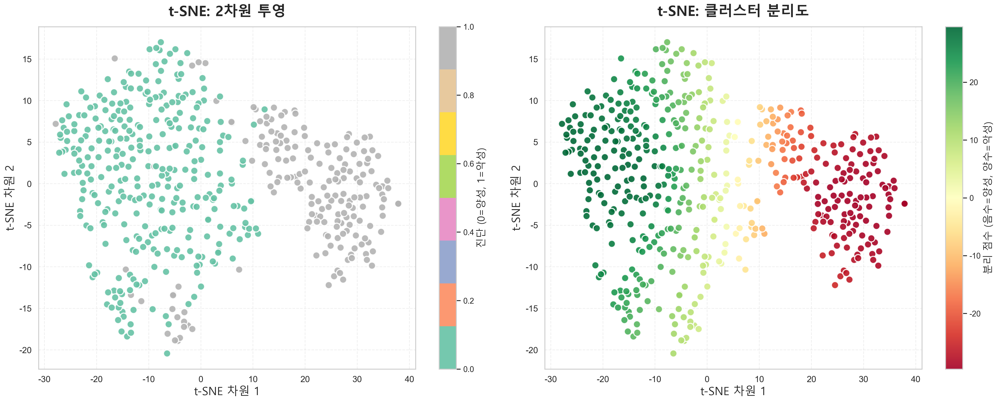

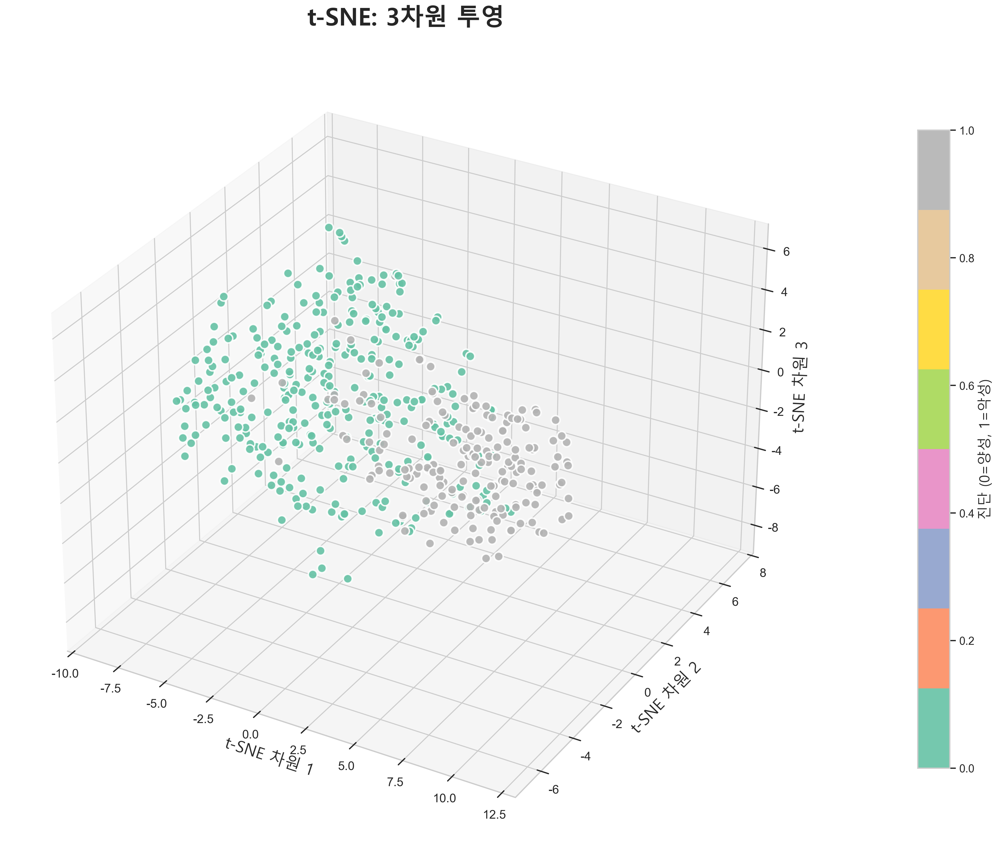


t-SNE 인터랙티브 3D 시각화 생성 중...
✅ t-SNE 인터랙티브 3D 그래프가 'tsne_3d_interactive.html' 파일로 저장되었습니다!
   파일 경로: c:\Users\angel\OneDrive\Documents\breast\tsne_3d_interactive.html
노트북 내 표시 중 오류 발생 (HTML 저장은 정상): Mime type rendering requires nbformat>=4.2.0 but it is not installed

✅ t-SNE 완료!


In [69]:
# ============================================
# 시각화8: t-SNE (t-Distributed Stochastic Neighbor Embedding)
# ============================================
print("\n" + "=" * 70)
print("2. t-SNE (t-Distributed Stochastic Neighbor Embedding)")
print("=" * 70)

# 필요한 라이브러리 import
import numpy as np

# 데이터 준비 (X_vis가 없으면 생성)
try:
    # X_vis가 이미 정의되어 있는지 확인
    _ = X_vis
    _ = y_vis
    print("기존 X_vis, y_vis 사용")
except NameError:
    print("데이터 준비 중...")
    try:
        ensure_df_scaled()
    except:
        # ensure_df_scaled가 실패하면 직접 데이터 로드
        import pandas as pd
        from sklearn.preprocessing import StandardScaler
        
        if 'df' not in globals():
            df = pd.read_csv("kr_data.csv")
        
        # 진단 인코딩
        if df['진단'].dtype == 'object':
            df['진단'] = df['진단'].map({'M': 1, 'B': 0})
        
        # 특징 선택
        feature_cols_vis = [col for col in df.columns if col not in ['id', '진단', 'Unnamed: 32']]
        
        # 스케일링
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(df[feature_cols_vis])
        df_scaled = pd.DataFrame(X_scaled, columns=feature_cols_vis)
        df_scaled['진단'] = df['진단'].values
    
    # 특징과 타겟 분리
    feature_cols_vis = [col for col in df_scaled.columns if col != '진단']
    X_vis = df_scaled[feature_cols_vis].values
    y_vis = df_scaled['진단'].values
    
    # 샘플링 (너무 많으면 계산 시간이 오래 걸림)
    sample_size = min(500, len(X_vis))
    if len(X_vis) > sample_size:
        sample_idx = np.random.choice(len(X_vis), sample_size, replace=False)
        X_vis = X_vis[sample_idx]
        y_vis = y_vis[sample_idx]
        print(f"샘플링: {sample_size}개 샘플 사용")
    else:
        print(f"전체 {len(X_vis)}개 샘플 사용")
    
    print(f"데이터 shape: {X_vis.shape}")
    print(f"타겟 분포: 양성(B)={np.sum(y_vis==0)}, 악성(M)={np.sum(y_vis==1)}")

# t-SNE 패키지 확인 및 설치 시도
try:
    from sklearn.manifold import TSNE
    print("\n✅ sklearn.manifold.TSNE 사용 가능")
except ImportError:
    print("⚠️ t-SNE를 찾을 수 없습니다.")
    raise

# t-SNE 계산 (2D, 3D) - 계산 시간이 오래 걸릴 수 있음
print("\nt-SNE 계산 중... (시간이 걸릴 수 있습니다)")
print("   - perplexity: 30, max_iter: 1000, random_state: 42")

tsne_2d = TSNE(n_components=2, perplexity=30, max_iter=1000, random_state=42, verbose=0)
X_tsne_2d = tsne_2d.fit_transform(X_vis)

tsne_3d = TSNE(n_components=3, perplexity=30, max_iter=1000, random_state=42, verbose=0)
X_tsne_3d = tsne_3d.fit_transform(X_vis)

print("t-SNE 계산 완료!")

# ========== t-SNE 2D 시각화 (컬러풀 버전 - plasma 컬러맵) ==========
fig, axes = plt.subplots(1, 2, figsize=(20, 8), dpi=300)

# 왼쪽: t-SNE 2D 투영 (쨍한 파스텔 톤 컬러맵)
scatter = axes[0].scatter(X_tsne_2d[:, 0], X_tsne_2d[:, 1], 
                         c=y_vis, cmap='Set2', s=100, alpha=0.9, 
                         edgecolors='white', linewidth=1.5)
cbar = plt.colorbar(scatter, ax=axes[0])
if selected_font:
    axes[0].set_xlabel('t-SNE 차원 1', fontsize=16, fontfamily=selected_font)
    axes[0].set_ylabel('t-SNE 차원 2', fontsize=16, fontfamily=selected_font)
    axes[0].set_title('t-SNE: 2차원 투영', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    axes[0].set_xlabel('t-SNE 차원 1', fontsize=16)
    axes[0].set_ylabel('t-SNE 차원 2', fontsize=16)
    axes[0].set_title('t-SNE: 2차원 투영', fontsize=20, fontweight='bold', pad=15)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14)
axes[0].grid(True, alpha=0.3, linestyle='--')
axes[0].tick_params(labelsize=12)

# 오른쪽: 클러스터 분리도 시각화 (거리 기반)
# 각 클래스의 중심점 계산
benign_center = X_tsne_2d[y_vis == 0].mean(axis=0)
malignant_center = X_tsne_2d[y_vis == 1].mean(axis=0)
# 각 점에서 두 중심점까지의 거리 차이
dist_to_benign = np.sqrt(((X_tsne_2d - benign_center)**2).sum(axis=1))
dist_to_malignant = np.sqrt(((X_tsne_2d - malignant_center)**2).sum(axis=1))
separation_score = dist_to_malignant - dist_to_benign  # 양수면 악성에 가까움

scatter2 = axes[1].scatter(X_tsne_2d[:, 0], X_tsne_2d[:, 1], 
                          c=separation_score, cmap='RdYlGn', s=100, alpha=0.9, 
                          edgecolors='white', linewidth=1.5)
cbar2 = plt.colorbar(scatter2, ax=axes[1])
if selected_font:
    axes[1].set_xlabel('t-SNE 차원 1', fontsize=16, fontfamily=selected_font)
    axes[1].set_ylabel('t-SNE 차원 2', fontsize=16, fontfamily=selected_font)
    axes[1].set_title('t-SNE: 클러스터 분리도', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font)
    cbar2.set_label('분리 점수 (음수=양성, 양수=악성)', fontsize=14, fontfamily=selected_font)
else:
    axes[1].set_xlabel('t-SNE 차원 1', fontsize=16)
    axes[1].set_ylabel('t-SNE 차원 2', fontsize=16)
    axes[1].set_title('t-SNE: 클러스터 분리도', fontsize=20, fontweight='bold', pad=15)
    cbar2.set_label('분리 점수 (음수=양성, 양수=악성)', fontsize=14)
axes[1].grid(True, alpha=0.3, linestyle='--')
axes[1].tick_params(labelsize=12)

plt.tight_layout()
plt.show()

# ========== t-SNE 3D 시각화 (컬러풀 버전 - plasma 컬러맵) ==========
fig_3d = plt.figure(figsize=(16, 12), dpi=300)
ax_3d = fig_3d.add_subplot(111, projection='3d')

# 쨍한 파스텔 톤 컬러맵 사용
scatter_3d = ax_3d.scatter(X_tsne_3d[:, 0], X_tsne_3d[:, 1], X_tsne_3d[:, 2],
                          c=y_vis, cmap='Set2', s=80, alpha=0.9, 
                          edgecolors='white', linewidth=1.5)
cbar_3d = plt.colorbar(scatter_3d, ax=ax_3d, pad=0.1, shrink=0.8)

if selected_font:
    ax_3d.set_xlabel('t-SNE 차원 1', fontsize=16, fontfamily=selected_font)
    ax_3d.set_ylabel('t-SNE 차원 2', fontsize=16, fontfamily=selected_font)
    ax_3d.set_zlabel('t-SNE 차원 3', fontsize=16, fontfamily=selected_font)
    ax_3d.set_title('t-SNE: 3차원 투영', fontsize=24, fontweight='bold', pad=25, fontfamily=selected_font)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    ax_3d.set_xlabel('t-SNE 차원 1', fontsize=16)
    ax_3d.set_ylabel('t-SNE 차원 2', fontsize=16)
    ax_3d.set_zlabel('t-SNE 차원 3', fontsize=16)
    ax_3d.set_title('t-SNE: 3차원 투영', fontsize=24, fontweight='bold', pad=25)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14)
ax_3d.tick_params(labelsize=12)
plt.tight_layout()
plt.show()

# ========== t-SNE 인터랙티브 HTML ==========
print("\nt-SNE 인터랙티브 3D 시각화 생성 중...")

# 마스크 정의 (y_vis 기반)
benign_mask = y_vis == 0  # 양성(B)
malignant_mask = y_vis == 1  # 악성(M)

fig_tsne = go.Figure()

# 양성(B) - 쨍한 스카이 블루
fig_tsne.add_trace(go.Scatter3d(
    x=X_tsne_3d[benign_mask, 0],
    y=X_tsne_3d[benign_mask, 1],
    z=X_tsne_3d[benign_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#4ECDC4', opacity=0.9, line=dict(width=1.5, color='white')),
    name='양성(B)',
    hovertemplate='<b>양성(B)</b><br>t-SNE 차원 1: %{x:.3f}<br>t-SNE 차원 2: %{y:.3f}<br>t-SNE 차원 3: %{z:.3f}<extra></extra>'
))

# 악성(M) - 쨍한 라벤더 핑크
fig_tsne.add_trace(go.Scatter3d(
    x=X_tsne_3d[malignant_mask, 0],
    y=X_tsne_3d[malignant_mask, 1],
    z=X_tsne_3d[malignant_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#FF8CC8', opacity=0.9, line=dict(width=1.5, color='white')),
    name='악성(M)',
    hovertemplate='<b>악성(M)</b><br>t-SNE 차원 1: %{x:.3f}<br>t-SNE 차원 2: %{y:.3f}<br>t-SNE 차원 3: %{z:.3f}<extra></extra>'
))

fig_tsne.update_layout(
    title=dict(
        text='t-SNE: 3D 확률적 이웃 임베딩 인터랙티브 시각화 (마우스로 회전/확대)',
        x=0.5,
        font=dict(size=18)
    ),
    scene=dict(
        xaxis_title='t-SNE 차원 1',
        yaxis_title='t-SNE 차원 2',
        zaxis_title='t-SNE 차원 3',
        camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
    ),
    width=1000,
    height=800,
    hovermode='closest',
    legend=dict(x=1.02, y=1, bgcolor='rgba(255, 255, 255, 0.8)', bordercolor='black', borderwidth=1)
)

html_filename_tsne = 'tsne_3d_interactive.html'
fig_tsne.write_html(html_filename_tsne)
print(f"✅ t-SNE 인터랙티브 3D 그래프가 '{html_filename_tsne}' 파일로 저장되었습니다!")
print(f"   파일 경로: {os.path.abspath(html_filename_tsne)}")

try:
    fig_tsne.show()
except Exception as e:
    print(f"노트북 내 표시 중 오류 발생 (HTML 저장은 정상): {str(e)}")

print("\n✅ t-SNE 완료!")



3. UMAP (Uniform Manifold Approximation and Projection)
기존 X_vis, y_vis 사용

✅ umap-learn 패키지 사용 가능

UMAP 계산 중... (시간이 걸릴 수 있습니다)
   - n_neighbors: 15, min_dist: 0.1, random_state: 42


c:\Users\angel\OneDrive\Documents\breast\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

c:\Users\angel\OneDrive\Documents\breast\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



UMAP 계산 완료!


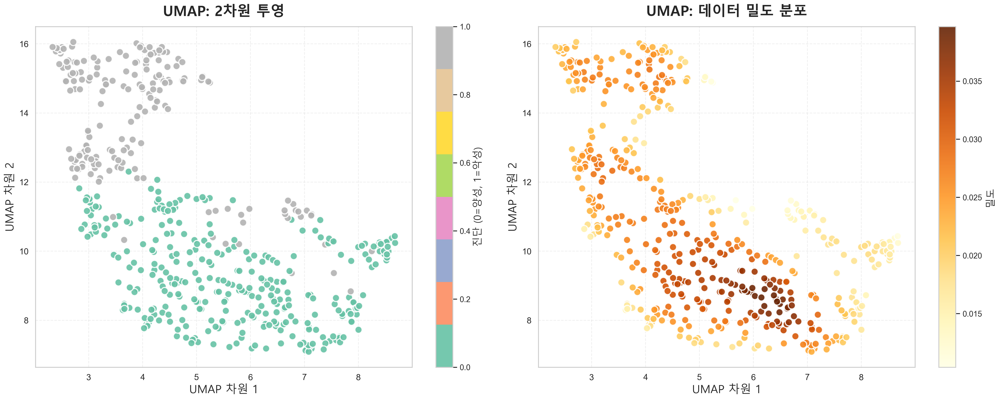

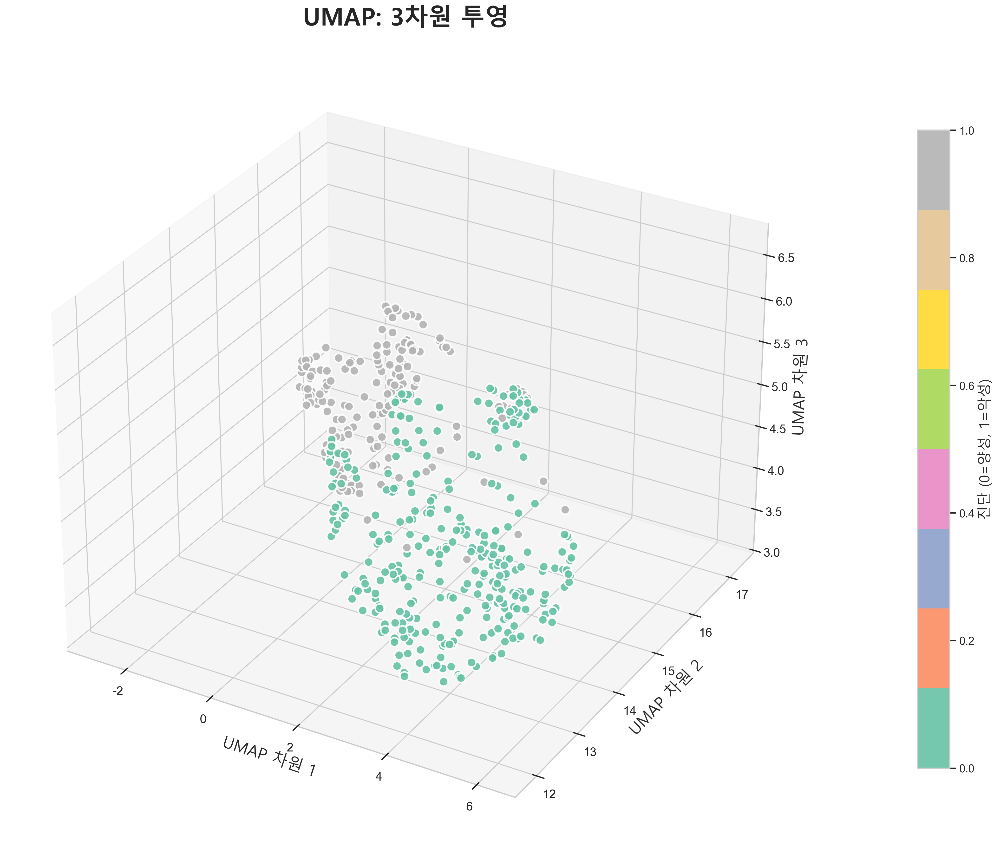


UMAP 인터랙티브 3D 시각화 생성 중...
✅ UMAP 인터랙티브 3D 그래프가 'umap_3d_interactive.html' 파일로 저장되었습니다!
   파일 경로: c:\Users\angel\OneDrive\Documents\breast\umap_3d_interactive.html
노트북 내 표시 중 오류 발생 (HTML 저장은 정상): Mime type rendering requires nbformat>=4.2.0 but it is not installed

✅ UMAP 완료!


In [70]:
# ============================================
# 시각화 9: UMAP (Uniform Manifold Approximation and Projection)
# ============================================
print("\n" + "=" * 70)
print("3. UMAP (Uniform Manifold Approximation and Projection)")
print("=" * 70)

# 필요한 라이브러리 import
import numpy as np

# 데이터 준비 (X_vis가 없으면 생성)
try:
    # X_vis가 이미 정의되어 있는지 확인
    _ = X_vis
    _ = y_vis
    print("기존 X_vis, y_vis 사용")
except NameError:
    print("데이터 준비 중...")
    try:
        ensure_df_scaled()
    except:
        # ensure_df_scaled가 실패하면 직접 데이터 로드
        import pandas as pd
        from sklearn.preprocessing import StandardScaler
        
        if 'df' not in globals():
            df = pd.read_csv("kr_data.csv")
        
        # 진단 인코딩
        if df['진단'].dtype == 'object':
            df['진단'] = df['진단'].map({'M': 1, 'B': 0})
        
        # 특징 선택
        feature_cols_vis = [col for col in df.columns if col not in ['id', '진단', 'Unnamed: 32']]
        
        # 스케일링
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(df[feature_cols_vis])
        df_scaled = pd.DataFrame(X_scaled, columns=feature_cols_vis)
        df_scaled['진단'] = df['진단'].values
    
    # 특징과 타겟 분리
    feature_cols_vis = [col for col in df_scaled.columns if col != '진단']
    X_vis = df_scaled[feature_cols_vis].values
    y_vis = df_scaled['진단'].values
    
    # 샘플링 (너무 많으면 계산 시간이 오래 걸림)
    sample_size = min(500, len(X_vis))
    if len(X_vis) > sample_size:
        sample_idx = np.random.choice(len(X_vis), sample_size, replace=False)
        X_vis = X_vis[sample_idx]
        y_vis = y_vis[sample_idx]
        print(f"샘플링: {sample_size}개 샘플 사용")
    else:
        print(f"전체 {len(X_vis)}개 샘플 사용")
    
    print(f"데이터 shape: {X_vis.shape}")
    print(f"타겟 분포: 양성(B)={np.sum(y_vis==0)}, 악성(M)={np.sum(y_vis==1)}")

# UMAP 패키지 확인 및 설치 시도
try:
    import umap
    print("\n✅ umap-learn 패키지 사용 가능")
except ImportError:
    print("⚠️ umap-learn 패키지를 찾을 수 없습니다. 자동 설치를 시도합니다...")
    import sys
    import subprocess
    try:
        subprocess.check_call([sys.executable, "-m", "pip", "install", "umap-learn", "--quiet"])
        import umap
        print("✅ umap-learn 설치 완료!")
    except Exception as e:
        print(f"❌ 자동 설치 실패: {e}")
        print("   수동 설치: pip install umap-learn")
        raise

# UMAP 계산 (2D, 3D)
print("\nUMAP 계산 중... (시간이 걸릴 수 있습니다)")
print("   - n_neighbors: 15, min_dist: 0.1, random_state: 42")

umap_2d = umap.UMAP(
    n_components=2,
    random_state=42,
    n_neighbors=15,
    min_dist=0.1,
    metric='euclidean'
)
X_umap_2d = umap_2d.fit_transform(X_vis)

umap_3d = umap.UMAP(
    n_components=3,
    random_state=42,
    n_neighbors=15,
    min_dist=0.1,
    metric='euclidean'
)
X_umap_3d = umap_3d.fit_transform(X_vis)

print("UMAP 계산 완료!")

# ========== UMAP 2D 시각화 (컬러풀 버전 - turbo 컬러맵) ==========
fig, axes = plt.subplots(1, 2, figsize=(20, 8), dpi=300)

# 왼쪽: UMAP 2D 투영 (쨍한 파스텔 톤 컬러맵)
scatter = axes[0].scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], 
                         c=y_vis, cmap='Set2', s=100, alpha=0.9, 
                         edgecolors='white', linewidth=1.5)
cbar = plt.colorbar(scatter, ax=axes[0])
if selected_font:
    axes[0].set_xlabel('UMAP 차원 1', fontsize=16, fontfamily=selected_font)
    axes[0].set_ylabel('UMAP 차원 2', fontsize=16, fontfamily=selected_font)
    axes[0].set_title('UMAP: 2차원 투영', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    axes[0].set_xlabel('UMAP 차원 1', fontsize=16)
    axes[0].set_ylabel('UMAP 차원 2', fontsize=16)
    axes[0].set_title('UMAP: 2차원 투영', fontsize=20, fontweight='bold', pad=15)
    cbar.set_label('진단 (0=양성, 1=악성)', fontsize=14)
axes[0].grid(True, alpha=0.3, linestyle='--')
axes[0].tick_params(labelsize=12)

# 오른쪽: 밀도 기반 시각화 (KDE)
from scipy.stats import gaussian_kde
# 각 클래스의 밀도 계산
benign_points = X_umap_2d[y_vis == 0]
malignant_points = X_umap_2d[y_vis == 1]

# 전체 데이터에 대한 밀도 계산
density = gaussian_kde(X_umap_2d.T)(X_umap_2d.T)
scatter2 = axes[1].scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], 
                          c=density, cmap='YlOrBr', s=100, alpha=0.9, 
                          edgecolors='white', linewidth=1.5)
cbar2 = plt.colorbar(scatter2, ax=axes[1])
if selected_font:
    axes[1].set_xlabel('UMAP 차원 1', fontsize=16, fontfamily=selected_font)
    axes[1].set_ylabel('UMAP 차원 2', fontsize=16, fontfamily=selected_font)
    axes[1].set_title('UMAP: 데이터 밀도 분포', fontsize=20, fontweight='bold', pad=15, fontfamily=selected_font)
    cbar2.set_label('밀도', fontsize=14, fontfamily=selected_font)
else:
    axes[1].set_xlabel('UMAP 차원 1', fontsize=16)
    axes[1].set_ylabel('UMAP 차원 2', fontsize=16)
    axes[1].set_title('UMAP: 데이터 밀도 분포', fontsize=20, fontweight='bold', pad=15)
    cbar2.set_label('밀도', fontsize=14)
axes[1].grid(True, alpha=0.3, linestyle='--')
axes[1].tick_params(labelsize=12)

plt.tight_layout()
plt.show()

# ========== UMAP 3D 시각화 (컬러풀 버전 - turbo 컬러맵) ==========
fig_3d = plt.figure(figsize=(16, 12), dpi=300)
ax_3d = fig_3d.add_subplot(111, projection='3d')

# 쨍한 파스텔 톤 컬러맵 사용
scatter_3d = ax_3d.scatter(X_umap_3d[:, 0], X_umap_3d[:, 1], X_umap_3d[:, 2],
                          c=y_vis, cmap='Set2', s=80, alpha=0.9, 
                          edgecolors='white', linewidth=1.5)
cbar_3d = plt.colorbar(scatter_3d, ax=ax_3d, pad=0.1, shrink=0.8)

if selected_font:
    ax_3d.set_xlabel('UMAP 차원 1', fontsize=16, fontfamily=selected_font)
    ax_3d.set_ylabel('UMAP 차원 2', fontsize=16, fontfamily=selected_font)
    ax_3d.set_zlabel('UMAP 차원 3', fontsize=16, fontfamily=selected_font)
    ax_3d.set_title('UMAP: 3차원 투영', fontsize=24, fontweight='bold', pad=25, fontfamily=selected_font)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14, fontfamily=selected_font)
else:
    ax_3d.set_xlabel('UMAP 차원 1', fontsize=16)
    ax_3d.set_ylabel('UMAP 차원 2', fontsize=16)
    ax_3d.set_zlabel('UMAP 차원 3', fontsize=16)
    ax_3d.set_title('UMAP: 3차원 투영', fontsize=24, fontweight='bold', pad=25)
    cbar_3d.set_label('진단 (0=양성, 1=악성)', fontsize=14)
ax_3d.tick_params(labelsize=12)
plt.tight_layout()
plt.show()

# ========== UMAP 인터랙티브 HTML ==========
print("\nUMAP 인터랙티브 3D 시각화 생성 중...")

# 마스크 정의 (y_vis 기반)
benign_mask = y_vis == 0  # 양성(B)
malignant_mask = y_vis == 1  # 악성(M)

fig_umap = go.Figure()

# 양성(B) - 쨍한 옐로우 그린
fig_umap.add_trace(go.Scatter3d(
    x=X_umap_3d[benign_mask, 0],
    y=X_umap_3d[benign_mask, 1],
    z=X_umap_3d[benign_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#FFE66D', opacity=0.9, line=dict(width=1.5, color='white')),
    name='양성(B)',
    hovertemplate='<b>양성(B)</b><br>UMAP 차원 1: %{x:.3f}<br>UMAP 차원 2: %{y:.3f}<br>UMAP 차원 3: %{z:.3f}<extra></extra>'
))

# 악성(M) - 쨍한 코랄 핑크
fig_umap.add_trace(go.Scatter3d(
    x=X_umap_3d[malignant_mask, 0],
    y=X_umap_3d[malignant_mask, 1],
    z=X_umap_3d[malignant_mask, 2],
    mode='markers',
    marker=dict(size=9, color='#FF6B6B', opacity=0.9, line=dict(width=1.5, color='white')),
    name='악성(M)',
    hovertemplate='<b>악성(M)</b><br>UMAP 차원 1: %{x:.3f}<br>UMAP 차원 2: %{y:.3f}<br>UMAP 차원 3: %{z:.3f}<extra></extra>'
))

fig_umap.update_layout(
    title=dict(
        text='UMAP: 3D 매니폴드 학습 기반 차원 축소 인터랙티브 시각화 (마우스로 회전/확대)',
        x=0.5,
        font=dict(size=18)
    ),
    scene=dict(
        xaxis_title='UMAP 차원 1',
        yaxis_title='UMAP 차원 2',
        zaxis_title='UMAP 차원 3',
        camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
    ),
    width=1000,
    height=800,
    hovermode='closest',
    legend=dict(x=1.02, y=1, bgcolor='rgba(255, 255, 255, 0.8)', bordercolor='black', borderwidth=1)
)

html_filename_umap = 'umap_3d_interactive.html'
fig_umap.write_html(html_filename_umap)
print(f"✅ UMAP 인터랙티브 3D 그래프가 '{html_filename_umap}' 파일로 저장되었습니다!")
print(f"   파일 경로: {os.path.abspath(html_filename_umap)}")

try:
    fig_umap.show()
except Exception as e:
    print(f"노트북 내 표시 중 오류 발생 (HTML 저장은 정상): {str(e)}")

print("\n✅ UMAP 완료!")


사용하는 feature 개수: 30
예시 feature: ['반경 평균', '조직 평균', '둘레 길이 평균', '면적 평균', '매끄러움 평균']
⚠️ squarify.plot 오류 발생: matplotlib.axes._axes.Axes.text() got multiple values for keyword argument 'ha'
대체 방법으로 시도합니다...


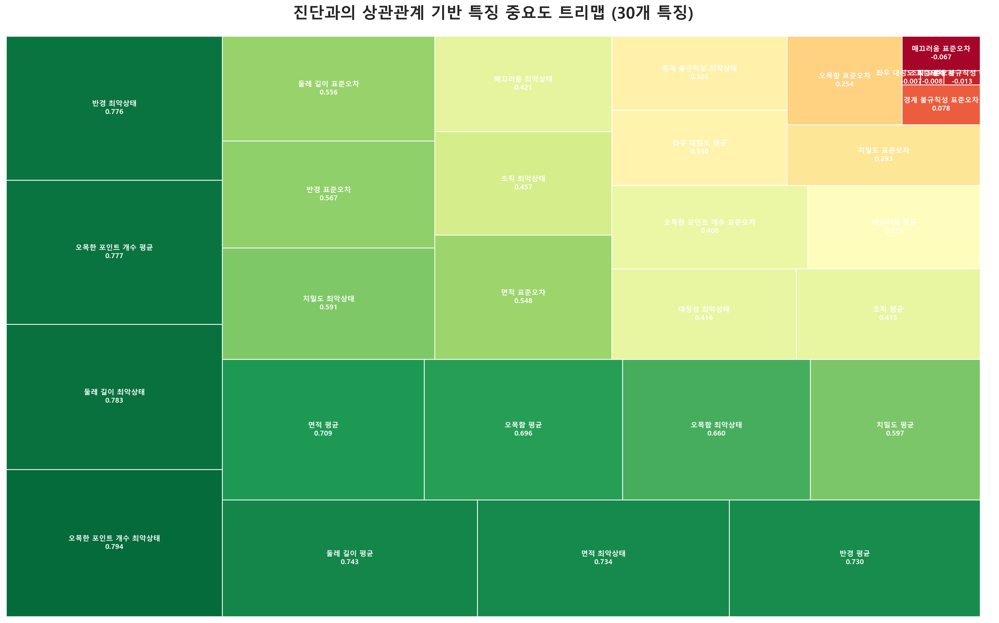

✅ 트리맵 완료: 30개 특징 사용
상위 5개 특징: ['오목한 포인트 개수 최악상태', '둘레 길이 최악상태', '오목한 포인트 개수 평균', '반경 최악상태', '둘레 길이 평균']


In [71]:
# 시각화 10 트리맵
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import squarify  # pip install squarify
import matplotlib.font_manager as fm
import matplotlib.colors as mcolors

# 한글 폰트 설정 (한글 깨짐 방지)
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for f in korean_fonts:
    if f in font_list:
        selected_font = f
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# df가 없으면 데이터 로드
if 'df' not in globals():
    try:
        df = pd.read_csv("kr_data.csv")
        print("✅ kr_data.csv 로드 완료")
    except:
        print("⚠️ df 변수가 없고 데이터 파일도 찾을 수 없습니다.")

# 타겟 컬럼 확인 (한글/영문 모두 지원)
if "진단" in df.columns:
    target_col = "진단"
elif "Diagnosis" in df.columns:
    target_col = "Diagnosis"
else:
    raise ValueError("'진단' 또는 'Diagnosis' 컬럼을 찾을 수 없습니다.")

# 문자열이면 숫자로 변환
if df[target_col].dtype == "object":
    df[target_col] = df[target_col].map({"M": 1, "B": 0, "악성(M)": 1, "양성(B)": 0, "악성": 1, "양성": 0})

# ==========================
# 2. feature 리스트 (동적으로 가져오기)
# ==========================
# id, 진단/Diagnosis, Unnamed: 32 제외한 모든 수치형 컬럼 사용
feature_cols = [c for c in df.columns if c not in ["id", "ID", target_col, "Unnamed: 32"]]
# 수치형 컬럼만 선택
feature_cols = [c for c in feature_cols if df[c].dtype in [np.int64, np.float64]]

if len(feature_cols) == 0:
    raise ValueError("사용 가능한 feature 컬럼이 없습니다.")

print(f"사용하는 feature 개수: {len(feature_cols)}")
print(f"예시 feature: {feature_cols[:5]}")

# ==========================
# 3. 상관계수 계산
# ==========================
corr = df[feature_cols].corrwith(df[target_col]).sort_values(ascending=False)

# NaN 값 제거 및 유효한 데이터만 선택
corr = corr.dropna()
if len(corr) == 0:
    raise ValueError("상관계수를 계산할 수 없습니다. 데이터를 확인해주세요.")

# 절대값 기준으로 중요도 표시
sizes = corr.abs().values
labels = corr.index.tolist()

# 0이나 음수 값 제거 (트리맵은 양수 값만 필요)
valid_mask = sizes > 0
sizes = sizes[valid_mask]
labels = [labels[i] for i in range(len(labels)) if valid_mask[i]]
corr_values = corr.values[valid_mask]

if len(sizes) == 0:
    raise ValueError("유효한 상관계수 값이 없습니다.")

# ==========================
# 4. 트리맵 시각화 (알록달록한 색상)
# ==========================
plt.figure(figsize=(16, 10), dpi=300)

# 상관계수 값에 따라 색상 강도 조정 (양수/음수 구분)
# NaN이나 무한대 값 처리
corr_values_clean = np.nan_to_num(corr_values, nan=0.0, posinf=1.0, neginf=-1.0)
norm_values = (corr_values_clean - corr_values_clean.min()) / (corr_values_clean.max() - corr_values_clean.min() + 1e-10)
colors = plt.cm.RdYlGn(norm_values)  # 빨강-노랑-초록 그라데이션

# 레이블 생성 (안전하게 처리)
label_list = []
for v, c in zip(labels, corr_values_clean):
    # 레이블이 너무 길면 줄임
    label_name = str(v)[:15] if len(str(v)) > 15 else str(v)
    label_text = f"{label_name}\n{c:.3f}"
    label_list.append(label_text)

# squarify.plot 안전하게 호출
try:
    # text_kwargs 지원 여부 확인 후 시도
    import inspect
    plot_signature = inspect.signature(squarify.plot)
    has_text_kwargs = 'text_kwargs' in plot_signature.parameters
    
    if has_text_kwargs:
        squarify.plot(
            sizes=sizes,
            label=label_list,
            alpha=0.85,
            color=colors,
            text_kwargs={'fontsize': 8, 'fontweight': 'bold', 'color': 'white', 
                        'ha': 'center', 'va': 'center'}
        )
    else:
        # text_kwargs를 지원하지 않는 버전
        squarify.plot(
            sizes=sizes,
            label=label_list,
            alpha=0.85,
            color=colors
        )
        # 텍스트 스타일을 수동으로 적용
        ax = plt.gca()
        for text in ax.texts:
            text.set_fontsize(8)
            text.set_fontweight('bold')
            text.set_color('white')
            text.set_horizontalalignment('center')
            text.set_verticalalignment('center')
            if selected_font:
                text.set_fontfamily(selected_font)
except Exception as e:
    print(f"⚠️ squarify.plot 오류 발생: {e}")
    print("대체 방법으로 시도합니다...")
    try:
        # 대체 방법: 레이블 없이 시도
        squarify.plot(
            sizes=sizes,
            label=None,
            alpha=0.85,
            color=colors
        )
        # 레이블을 수동으로 추가
        ax = plt.gca()
        for i, (label, size) in enumerate(zip(label_list, sizes)):
            if size > 0 and i < len(ax.patches):
                try:
                    # 각 사각형의 중심에 텍스트 추가
                    rect = ax.patches[i]
                    x, y = rect.get_xy()
                    w, h = rect.get_width(), rect.get_height()
                    if w > 0 and h > 0:  # 너무 작은 사각형은 건너뛰기
                        ax.text(x + w/2, y + h/2, label, 
                               ha='center', va='center', 
                               fontsize=8, fontweight='bold', color='white',
                               fontfamily=selected_font if selected_font else 'sans-serif')
                except Exception as ex:
                    # 개별 레이블 추가 실패는 무시
                    pass
    except Exception as e2:
        print(f"❌ 대체 방법도 실패: {e2}")
        raise

# 제목 (한글 폰트 적용)
title = f"진단과의 상관관계 기반 특징 중요도 트리맵 ({len(feature_cols)}개 특징)"
if selected_font:
    plt.title(title, fontsize=18, fontweight='bold', fontfamily=selected_font, pad=20)
else:
    plt.title(title, fontsize=18, fontweight='bold', pad=20)

plt.axis("off")
plt.tight_layout()
plt.show()

print(f"✅ 트리맵 완료: {len(feature_cols)}개 특징 사용")
print(f"상위 5개 특징: {labels[:5]}")


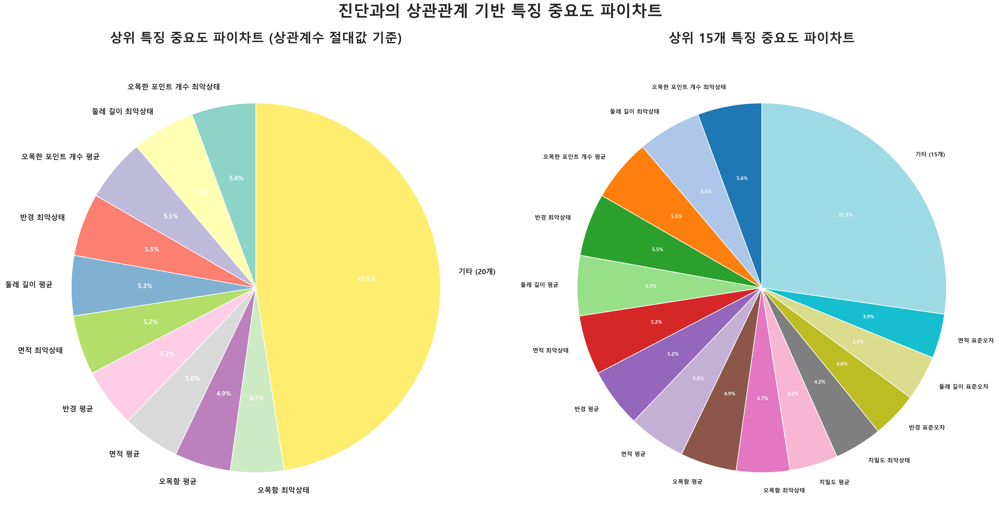

✅ 파이차트 완료: 30개 특징 중 상위 10개 및 15개 시각화
상위 5개 특징: ['오목한 포인트 개수 최악상태', '둘레 길이 최악상태', '오목한 포인트 개수 평균', '반경 최악상태', '둘레 길이 평균']


In [72]:
# 시각화 11: 특징 중요도 파이차트
# 트리맵 셀에서 계산한 상관계수 데이터 사용
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

# 한글 폰트 설정
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for f in korean_fonts:
    if f in font_list:
        selected_font = f
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# df가 없으면 데이터 로드
if 'df' not in globals():
    try:
        df = pd.read_csv("kr_data.csv")
        print("✅ kr_data.csv 로드 완료")
    except:
        print("⚠️ df 변수가 없고 데이터 파일도 찾을 수 없습니다.")

# 타겟 컬럼 확인
if "진단" in df.columns:
    target_col = "진단"
elif "Diagnosis" in df.columns:
    target_col = "Diagnosis"
else:
    raise ValueError("'진단' 또는 'Diagnosis' 컬럼을 찾을 수 없습니다.")

# 문자열이면 숫자로 변환
if df[target_col].dtype == "object":
    df[target_col] = df[target_col].map({"M": 1, "B": 0, "악성(M)": 1, "양성(B)": 0, "악성": 1, "양성": 0})

# feature 리스트
feature_cols = [c for c in df.columns if c not in ["id", "ID", target_col, "Unnamed: 32"]]
feature_cols = [c for c in feature_cols if df[c].dtype in [np.int64, np.float64]]

if len(feature_cols) == 0:
    raise ValueError("사용 가능한 feature 컬럼이 없습니다.")

# 상관계수 계산
corr = df[feature_cols].corrwith(df[target_col]).sort_values(ascending=False)
corr = corr.dropna()

# 절대값 기준으로 중요도 계산
sizes = corr.abs().values
labels = corr.index.tolist()

# 0이나 음수 값 제거
valid_mask = sizes > 0
sizes = sizes[valid_mask]
labels = [labels[i] for i in range(len(labels)) if valid_mask[i]]
corr_values = corr.values[valid_mask]

if len(sizes) == 0:
    raise ValueError("유효한 상관계수 값이 없습니다.")

# 상위 10개 특징 선택 (파이차트는 너무 많으면 보기 어려움)
top_n = min(10, len(sizes))
top_sizes = sizes[:top_n]
top_labels = labels[:top_n]
top_corr_values = corr_values[:top_n]

# 나머지 특징들을 "기타"로 합치기
if len(sizes) > top_n:
    other_size = np.sum(sizes[top_n:])
    top_sizes = np.append(top_sizes, other_size)
    top_labels = top_labels + [f'기타 ({len(sizes) - top_n}개)']
    top_corr_values = np.append(top_corr_values, 0)

# 파이차트 시각화
fig, axes = plt.subplots(1, 2, figsize=(20, 10), dpi=300)

# 파이차트 1: 상위 10개 특징 (비율 표시)
ax1 = axes[0]
colors_pie = plt.cm.Set3(np.linspace(0, 1, len(top_sizes)))
wedges, texts, autotexts = ax1.pie(
    top_sizes, 
    labels=top_labels, 
    autopct='%1.1f%%', 
    startangle=90, 
    colors=colors_pie,
    textprops={'fontsize': 11, 'fontweight': 'bold'}
)

# 텍스트 크기 조정
for text in texts:
    if selected_font:
        text.set_fontfamily(selected_font)
    text.set_fontsize(10)
for autotext in autotexts:
    autotext.set_fontsize(9)
    autotext.set_color('white')
    autotext.set_fontweight('bold')

if selected_font:
    ax1.set_title('상위 특징 중요도 파이차트 (상관계수 절대값 기준)', 
                 fontsize=18, fontweight='bold', pad=20, fontfamily=selected_font)
else:
    ax1.set_title('상위 특징 중요도 파이차트 (상관계수 절대값 기준)', 
                 fontsize=18, fontweight='bold', pad=20)

# 파이차트 2: 상위 15개 특징 (더 많은 특징 포함)
ax2 = axes[1]
top_n_2 = min(15, len(sizes))
top_sizes_2 = sizes[:top_n_2]
top_labels_2 = labels[:top_n_2]

if len(sizes) > top_n_2:
    other_size_2 = np.sum(sizes[top_n_2:])
    top_sizes_2 = np.append(top_sizes_2, other_size_2)
    top_labels_2 = top_labels_2 + [f'기타 ({len(sizes) - top_n_2}개)']

colors_pie_2 = plt.cm.tab20(np.linspace(0, 1, len(top_sizes_2)))
wedges2, texts2, autotexts2 = ax2.pie(
    top_sizes_2, 
    labels=top_labels_2, 
    autopct='%1.1f%%', 
    startangle=90, 
    colors=colors_pie_2,
    textprops={'fontsize': 9, 'fontweight': 'bold'}
)

# 텍스트 크기 조정
for text in texts2:
    if selected_font:
        text.set_fontfamily(selected_font)
    text.set_fontsize(8)
for autotext in autotexts2:
    autotext.set_fontsize(7)
    autotext.set_color('white')
    autotext.set_fontweight('bold')

if selected_font:
    ax2.set_title('상위 15개 특징 중요도 파이차트', 
                 fontsize=18, fontweight='bold', pad=20, fontfamily=selected_font)
else:
    ax2.set_title('상위 15개 특징 중요도 파이차트', 
                 fontsize=18, fontweight='bold', pad=20)

plt.suptitle('진단과의 상관관계 기반 특징 중요도 파이차트', 
             fontsize=22, fontweight='bold', y=1.02, 
             fontfamily=selected_font if selected_font else 'sans-serif')
plt.tight_layout()
plt.show()

print(f"✅ 파이차트 완료: {len(feature_cols)}개 특징 중 상위 {top_n}개 및 {top_n_2}개 시각화")
print(f"상위 5개 특징: {labels[:5]}")


In [73]:
# ============================================
# 모델 학습 및 평가
# ============================================
print("=" * 50)
print("모델 학습 및 평가")
print("=" * 50)

# 데이터 분할
X = df_scaled.drop(columns=['진단'])
y = df_scaled['진단']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

print(f"훈련 데이터: {X_train.shape[0]}개")
print(f"테스트 데이터: {X_test.shape[0]}개")

# 모델 학습
rf_clf = RandomForestClassifier(random_state=42, n_estimators=300, max_depth=None, n_jobs=-1)
dt_clf = DecisionTreeClassifier(random_state=42, max_depth=5)

print("\n모델 학습 중...")
rf_clf.fit(X_train, y_train)
dt_clf.fit(X_train, y_train)
print("모델 학습 완료!")

# 모델 평가
models = {'Random Forest': rf_clf, 'Decision Tree': dt_clf}

for name, model in models.items():
    y_pred = model.predict(X_test)
    print(f"\n{'='*50}")
    print(f"{name} 성능")
    print(f"{'='*50}")
    print(f"정확도: {accuracy_score(y_test, y_pred):.4f}")
    print(f"\n분류 보고서:")
    print(classification_report(y_test, y_pred, target_names=['양성(B)', '악성(M)']))
    print(f"\n혼동 행렬:")
    print(confusion_matrix(y_test, y_pred))


모델 학습 및 평가
훈련 데이터: 455개
테스트 데이터: 114개

모델 학습 중...
모델 학습 완료!

Random Forest 성능
정확도: 0.9386

분류 보고서:
              precision    recall  f1-score   support

       양성(B)       0.95      0.96      0.95        72
       악성(M)       0.93      0.90      0.92        42

    accuracy                           0.94       114
   macro avg       0.94      0.93      0.93       114
weighted avg       0.94      0.94      0.94       114


혼동 행렬:
[[69  3]
 [ 4 38]]

Decision Tree 성능
정확도: 0.9123

분류 보고서:
              precision    recall  f1-score   support

       양성(B)       0.91      0.96      0.93        72
       악성(M)       0.92      0.83      0.88        42

    accuracy                           0.91       114
   macro avg       0.91      0.90      0.90       114
weighted avg       0.91      0.91      0.91       114


혼동 행렬:
[[69  3]
 [ 7 35]]


XAI 1: SHAP 분석
기존 rf_clf 모델 사용!
SHAP 분석에 사용할 샘플 개수: 114
SHAP 값 계산 중...
SHAP 값 shape: (114, 10)

SHAP Summary Plot 생성 중...


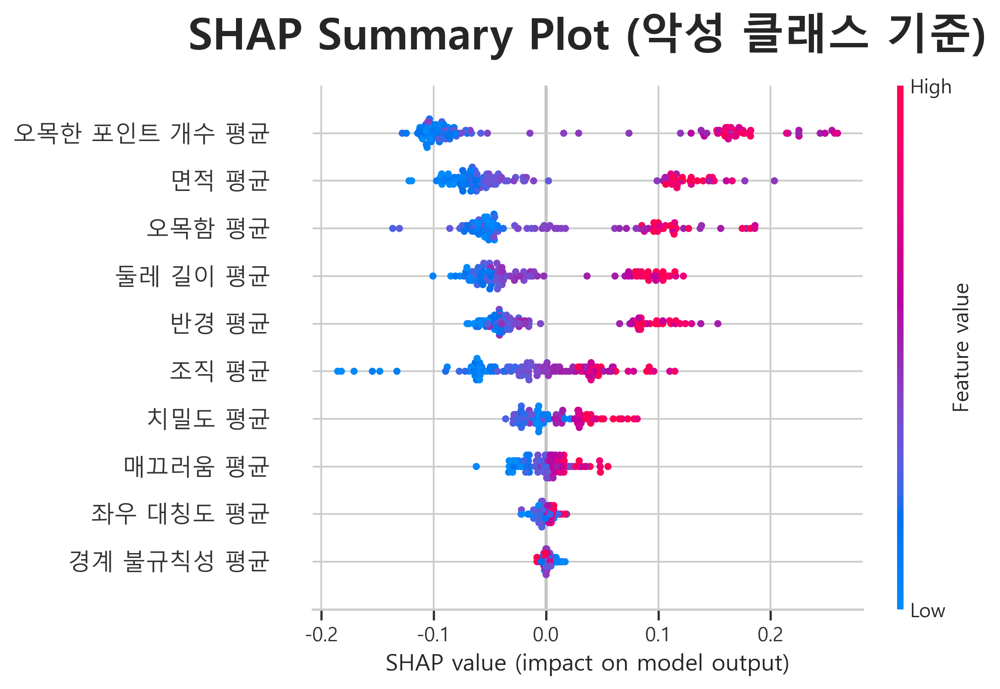


SHAP Bar Plot 생성 중...


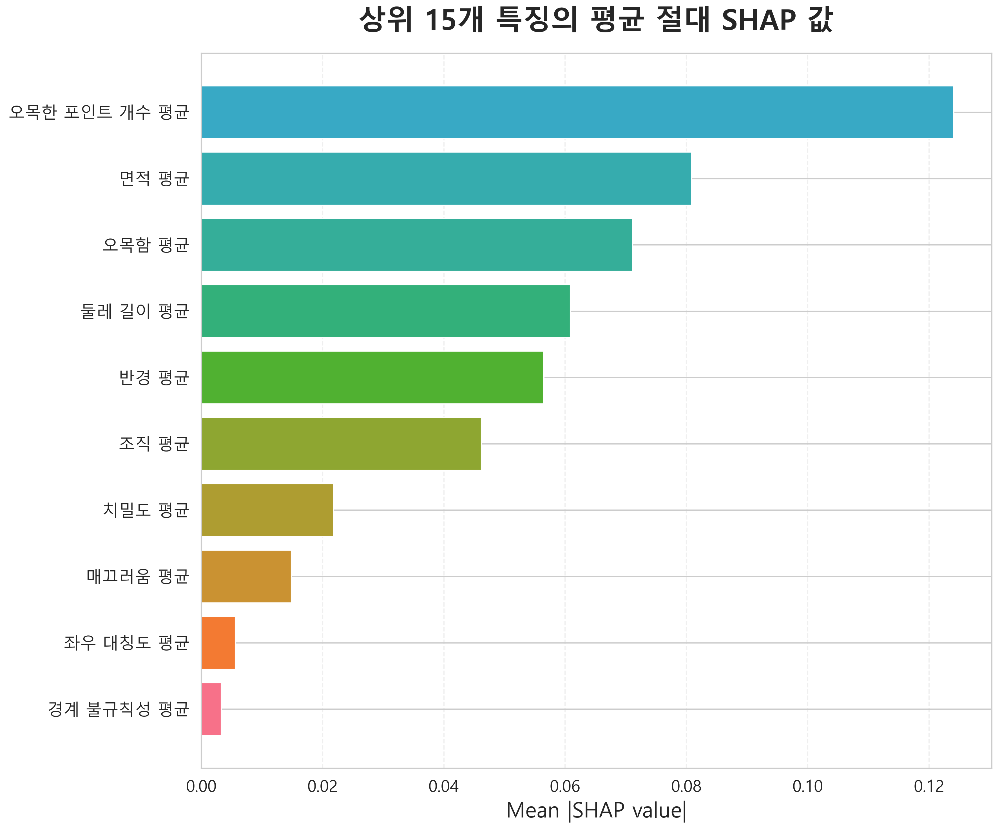

✅ SHAP 분석 완료!


In [74]:
# ============================================
# XAI 1: SHAP (SHapley Additive exPlanations)
# ============================================
print("=" * 50)
print("XAI 1: SHAP 분석")
print("=" * 50)

# 1) SHAP 라이브러리 확인
try:
    import shap
except ImportError:
    print("⚠️ shap 패키지가 설치되어 있지 않습니다.")
    print("   -> 터미널/콘솔에서:  pip install shap")
    raise

# 2) 데이터, 모델 다시 한 번 안전하게 준비
# df_scaled 에서 특징(X), 타깃(y) 분리
X = df_scaled.drop(columns=['진단'])
y = df_scaled['진단']

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

# 학습/테스트 데이터 분할 (이미 있다면 그대로 덮어써도 무방)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# RandomForest 모델 (이미 rf_clf가 있으면 재학습 안 해도 됨)
if 'rf_clf' not in globals():
    rf_clf = RandomForestClassifier(
        n_estimators=200,
        max_depth=None,
        random_state=42,
        n_jobs=-1
    )
    rf_clf.fit(X_train, y_train)
    print("RandomForest 새로 학습 완료!")
else:
    print("기존 rf_clf 모델 사용!")

# 3) SHAP용 샘플 추출 (너무 많으면 줄이기)
X_test_sample = X_test.copy()
if len(X_test_sample) > 300:
    X_test_sample = X_test_sample.sample(300, random_state=42)
print(f"SHAP 분석에 사용할 샘플 개수: {len(X_test_sample)}")

# 4) TreeExplainer 생성
explainer = shap.TreeExplainer(rf_clf)

# 5) SHAP 값 계산
print("SHAP 값 계산 중...")
shap_values = explainer.shap_values(X_test_sample)

# 6) 이진분류(breast cancer)에서 악성(1) 클래스 SHAP 값만 뽑기
import numpy as np

if isinstance(shap_values, list):
    # 보통 [클래스0, 클래스1] 리스트로 반환됨
    shap_values_class1 = shap_values[1]
else:
    # 배열인 경우: (n_samples, n_features) 또는 (n_samples, n_features, n_classes) 형태
    if shap_values.ndim == 3:
        # (샘플, 특성, 클래스)
        shap_values_class1 = shap_values[:, :, 1]
    else:
        shap_values_class1 = shap_values

print("SHAP 값 shape:", np.array(shap_values_class1).shape)

# 7) 요약 플롯 (Summary Plot, 고화질)
print("\nSHAP Summary Plot 생성 중...")
shap.initjs()  # JS 기반 시각화 (노트북에서)
plt.figure(figsize=(14, 10), dpi=300)
shap.summary_plot(
    shap_values_class1,
    X_test_sample,
    feature_names=X.columns.tolist(),
    show=False
)
if selected_font:
    plt.title("SHAP Summary Plot (악성 클래스 기준)", fontsize=24, fontweight='bold', fontfamily=selected_font, pad=20)
else:
    plt.title("SHAP Summary Plot (악성 클래스 기준)", fontsize=24, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

# 8) 바 플롯 (평균 절대 SHAP 값 기준 상위 특징, 컬러풀)
print("\nSHAP Bar Plot 생성 중...")
mean_shap = np.abs(shap_values_class1).mean(axis=0)
top_indices = np.argsort(mean_shap)[::-1][:15]

plt.figure(figsize=(12, 10), dpi=300)
colors_shap = sns.color_palette("husl", 15)
plt.barh(
    np.array(X.columns)[top_indices][::-1],
    mean_shap[top_indices][::-1],
    color=colors_shap
)
if selected_font:
    plt.xlabel("Mean |SHAP value|", fontsize=18, fontfamily=selected_font)
    plt.title("상위 15개 특징의 평균 절대 SHAP 값", fontsize=24, fontweight='bold', fontfamily=selected_font, pad=20)
    plt.tick_params(labelsize=14)
    for label in plt.gca().get_yticklabels():
        label.set_fontfamily(selected_font)
else:
    plt.xlabel("Mean |SHAP value|", fontsize=18)
    plt.title("상위 15개 특징의 평균 절대 SHAP 값", fontsize=24, fontweight='bold', pad=20)
    plt.tick_params(labelsize=14)
plt.grid(True, alpha=0.3, axis='x', linestyle='--')
plt.tight_layout()
plt.show()

print("✅ SHAP 분석 완료!")


XAI 2: Permutation Importance
기존 rf_clf 사용!
Permutation Importance 계산 중...


,feature,importance_mean,importance_std
1,조직 평균,0.031579,0.014783
7,오목한 포인트 개수 평균,0.027193,0.016620
6,오목함 평균,0.018421,0.012981
3,면적 평균,0.003947,0.010912
9,경계 불규칙성 평균,0.003070,0.005020
8,좌우 대칭도 평균,0.000877,0.006738
4,매끄러움 평균,-0.000877,0.008728
0,반경 평균,-0.003070,0.007980
5,치밀도 평균,-0.003509,0.006446
2,둘레 길이 평균,-0.007895,0.007287


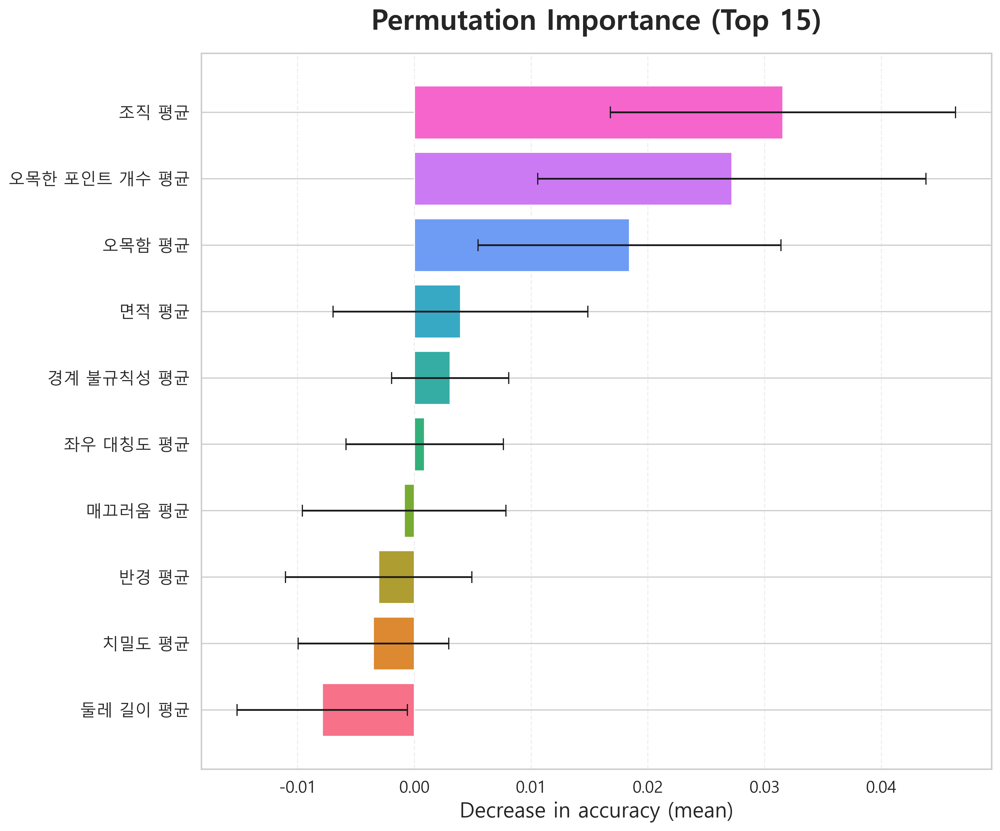

✅ Permutation Importance 완료!


In [75]:
# ============================================
# XAI 2: Permutation Importance
# ============================================
print("=" * 50)
print("XAI 2: Permutation Importance")
print("=" * 50)

from sklearn.inspection import permutation_importance

# 다시 한 번 X, y, train/test 준비 (위 셀과 동일하면 이 부분은 생략 가능)
X = df_scaled.drop(columns=['진단'])
y = df_scaled['진단']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

if 'rf_clf' not in globals():
    from sklearn.ensemble import RandomForestClassifier
    rf_clf = RandomForestClassifier(
        n_estimators=200,
        random_state=42,
        n_jobs=-1
    )
    rf_clf.fit(X_train, y_train)
    print("RandomForest 새로 학습 완료!")
else:
    print("기존 rf_clf 사용!")

# Permutation Importance 계산
print("Permutation Importance 계산 중...")
result = permutation_importance(
    rf_clf,
    X_test,
    y_test,
    n_repeats=20,
    random_state=42,
    n_jobs=-1
)

importances_mean = result.importances_mean
importances_std = result.importances_std

importance_df = pd.DataFrame({
    "feature": X.columns,
    "importance_mean": importances_mean,
    "importance_std": importances_std
}).sort_values("importance_mean", ascending=False)

display(importance_df.head(15))

# 시각화 (상위 15개 특징)
top_k = 15
top_imp = importance_df.head(top_k).iloc[::-1]  # 역순(아래->위)으로 그리기

# 컬러맵 생성 (칼라풀한 색상)
colors = sns.color_palette("husl", len(top_imp))

plt.figure(figsize=(12, 10), dpi=300)
plt.barh(top_imp["feature"], top_imp["importance_mean"],
         xerr=top_imp["importance_std"], color=colors, capsize=5)
if selected_font:
    plt.xlabel("Decrease in accuracy (mean)", fontsize=18, fontfamily=selected_font)
    plt.title(f"Permutation Importance (Top {top_k})", fontsize=24, fontweight='bold', fontfamily=selected_font, pad=20)
    plt.tick_params(labelsize=14)
    for label in plt.gca().get_yticklabels():
        label.set_fontfamily(selected_font)
else:
    plt.xlabel("Decrease in accuracy (mean)", fontsize=18)
    plt.title(f"Permutation Importance (Top {top_k})", fontsize=24, fontweight='bold', pad=20)
    plt.tick_params(labelsize=14)
plt.grid(True, alpha=0.3, axis='x', linestyle='--')
plt.tight_layout()
plt.show()

print("✅ Permutation Importance 완료!")


XAI 3: Partial Dependence / ICE Plot
기존 rf_clf 사용!
Partial Dependence를 그릴 특징: ['반경 평균', '조직 평균', '둘레 길이 평균', '면적 평균', '치밀도 평균']
- 반경 평균에 대한 Partial Dependence 계산 중...
- 조직 평균에 대한 Partial Dependence 계산 중...
- 둘레 길이 평균에 대한 Partial Dependence 계산 중...
- 면적 평균에 대한 Partial Dependence 계산 중...
- 치밀도 평균에 대한 Partial Dependence 계산 중...


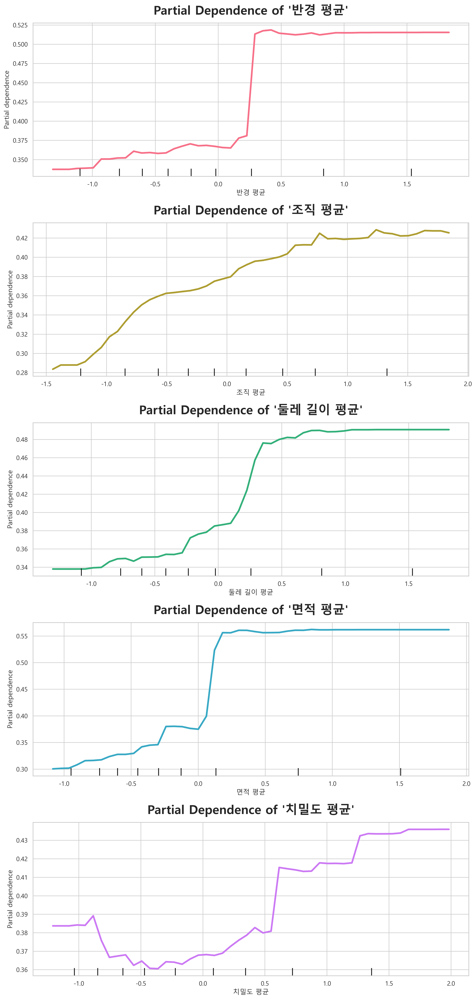

✅ Partial Dependence Plot 완료!


In [76]:
# ============================================
# XAI 3: Partial Dependence Plot & ICE
# ============================================
print("=" * 50)
print("XAI 3: Partial Dependence / ICE Plot")
print("=" * 50)

from sklearn.inspection import PartialDependenceDisplay

# 다시 한 번 X, y, train/test
X = df_scaled.drop(columns=['진단'])
y = df_scaled['진단']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

if 'rf_clf' not in globals():
    from sklearn.ensemble import RandomForestClassifier
    rf_clf = RandomForestClassifier(
        n_estimators=200,
        random_state=42,
        n_jobs=-1
    )
    rf_clf.fit(X_train, y_train)
    print("RandomForest 새로 학습 완료!")
else:
    print("기존 rf_clf 사용!")

# 부분 의존도(Partial Dependence)를 보고 싶은 특징 선택
target_features = [
    '반경 평균',
    '조직 평균',
    '둘레 길이 평균',
    '면적 평균',
    '치밀도 평균'
]
target_features = [f for f in target_features if f in X.columns]

print("Partial Dependence를 그릴 특징:", target_features)

if len(target_features) == 0:
    print("⚠️ 지정한 특징 이름이 데이터에 없습니다.")
else:
    fig, ax = plt.subplots(
        nrows=len(target_features),
        ncols=1,
        figsize=(12, 5 * len(target_features)),
        dpi=300
    )

    if len(target_features) == 1:
        ax = [ax]  # 인덱싱 편하게

    colors_pdp = sns.color_palette("husl", len(target_features))
    
    for i, feat in enumerate(target_features):
        print(f"- {feat}에 대한 Partial Dependence 계산 중...")
        PartialDependenceDisplay.from_estimator(
            rf_clf,
            X,
            [feat],
            ax=ax[i],
            kind='average',   # 평균 효과
            grid_resolution=50,
            line_kw={'color': colors_pdp[i], 'linewidth': 3}
        )
        if selected_font:
            ax[i].set_title(f"Partial Dependence of '{feat}'", fontsize=22, fontweight='bold', fontfamily=selected_font, pad=15)
            ax[i].set_xlabel(ax[i].get_xlabel(), fontsize=18, fontfamily=selected_font)
            ax[i].set_ylabel(ax[i].get_ylabel(), fontsize=18, fontfamily=selected_font)
        else:
            ax[i].set_title(f"Partial Dependence of '{feat}'", fontsize=22, fontweight='bold', pad=15)
            ax[i].set_xlabel(ax[i].get_xlabel(), fontsize=18)
            ax[i].set_ylabel(ax[i].get_ylabel(), fontsize=18)
        ax[i].tick_params(labelsize=14)
        ax[i].grid(True, alpha=0.3, linestyle='--')

    plt.tight_layout()
    plt.show()

print("✅ Partial Dependence Plot 완료!")


XAI 4: LIME 분석
기존 rf_clf 사용!

분석할 샘플:
  - 양성 샘플: 3개
  - 악성 샘플: 3개
  - 총 6개 샘플 분석
  ✅ 샘플 120 (양성(B)) 분석 완료
  ✅ 샘플 375 (양성(B)) 분석 완료
  ✅ 샘플 455 (양성(B)) 분석 완료
  ✅ 샘플 250 (악성(M)) 분석 완료
  ✅ 샘플 99 (악성(M)) 분석 완료
  ✅ 샘플 39 (악성(M)) 분석 완료

시각화 1: 샘플별 LIME 설명 (개별 분석)


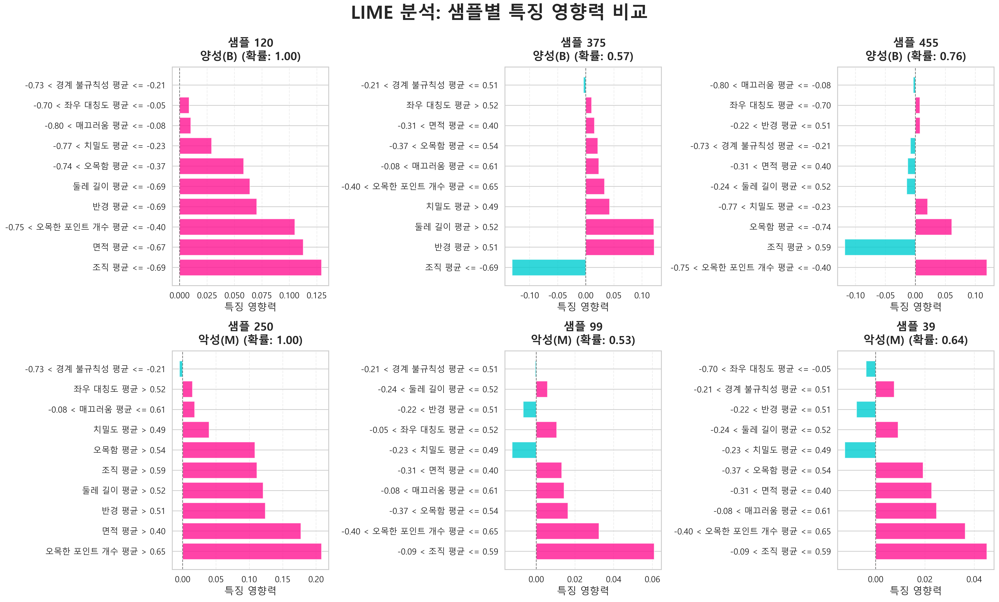


시각화 2: 주요 특징들의 평균 영향력 (양성 vs 악성)


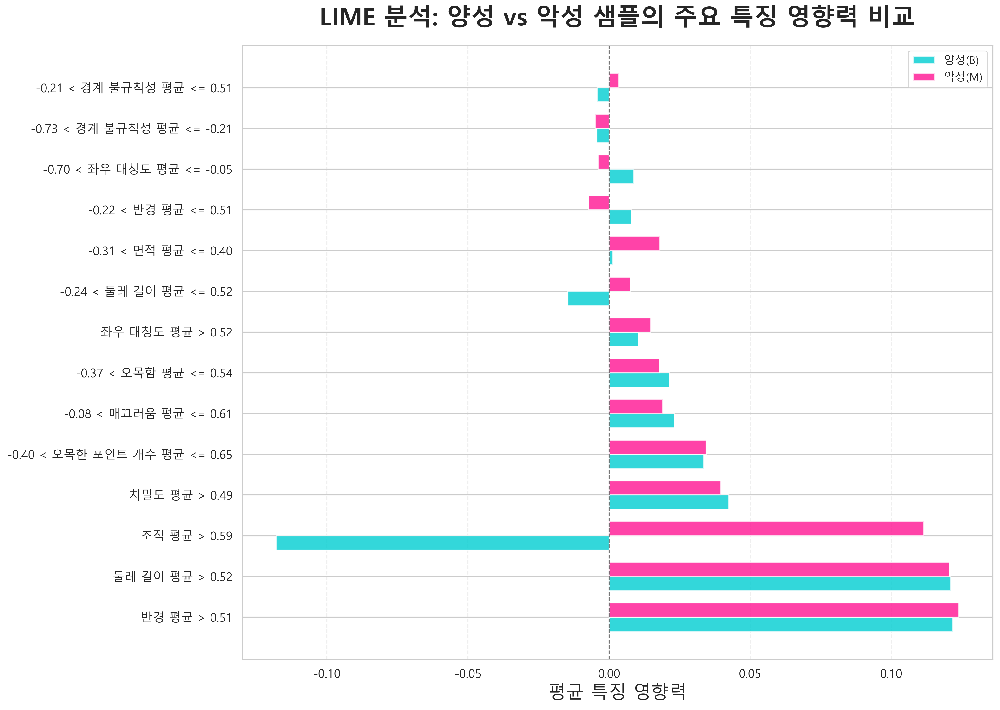


시각화 3: 첫 번째 샘플 상세 LIME 설명

샘플 인덱스: 120
실제 진단(y_true): 0 -> 양성(B)
예측 레이블(y_pred): 0 -> 양성(B)
예측 확률 [Benign, Malignant]: [1. 0.]
LIME에서 사용할 클래스 레이블(label): 0


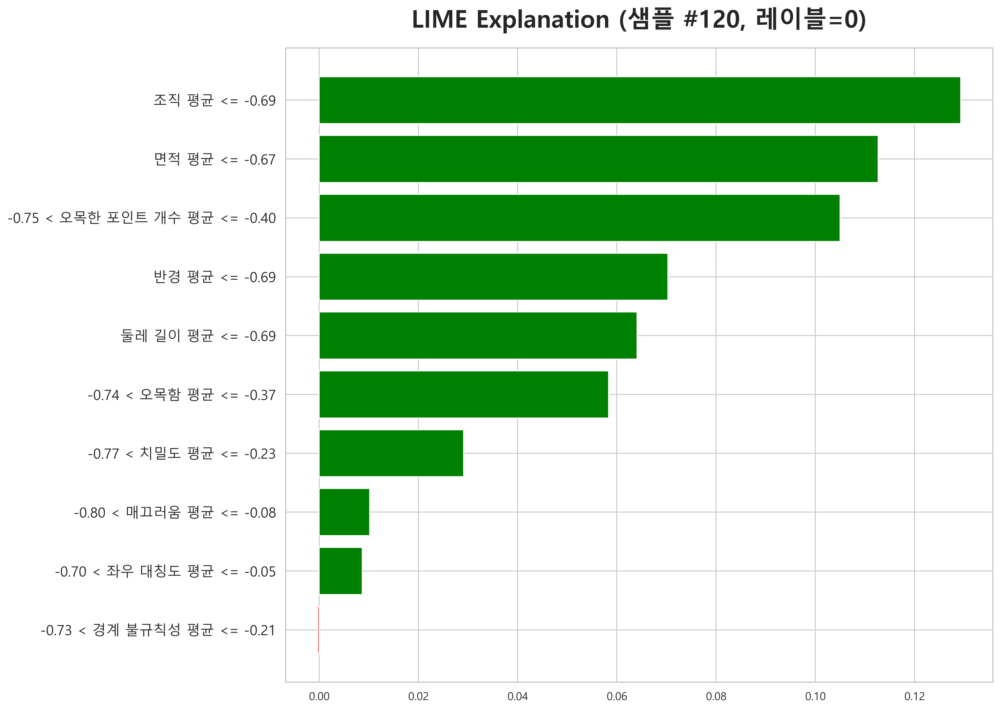


✅ LIME 분석 완료! (여러 샘플 및 특징 분석 포함)


In [77]:
# ============================================
# XAI 4: LIME (Local Interpretable Model-agnostic Explanations)
# ============================================
print("=" * 50)
print("XAI 4: LIME 분석")
print("=" * 50)

# 1) LIME 패키지 확인
try:
    from lime.lime_tabular import LimeTabularExplainer
except ImportError:
    print("⚠️ lime 패키지가 설치되어 있지 않습니다.")
    print("   -> 터미널/콘솔에서:  pip install lime")
    raise

# 2) 다시 X, y, train/test
X = df_scaled.drop(columns=['진단'])
y = df_scaled['진단']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

if 'rf_clf' not in globals():
    from sklearn.ensemble import RandomForestClassifier
    rf_clf = RandomForestClassifier(
        n_estimators=200,
        random_state=42,
        n_jobs=-1
    )
    rf_clf.fit(X_train, y_train)
    print("RandomForest 새로 학습 완료!")
else:
    print("기존 rf_clf 사용!")

# 3) LIME 설명자 생성
class_names = ['Benign(0)', 'Malignant(1)']

lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X.columns.tolist(),
    class_names=class_names,
    mode='classification',
    discretize_continuous=True
)

# 4) 여러 샘플 선택 (양성/악성 각각)
# 양성 샘플 찾기
benign_indices = X_test[y_test == 0].index[:3].tolist()  # 양성 샘플 3개
malignant_indices = X_test[y_test == 1].index[:3].tolist()  # 악성 샘플 3개

all_sample_indices = benign_indices + malignant_indices
print(f"\n분석할 샘플:")
print(f"  - 양성 샘플: {len(benign_indices)}개")
print(f"  - 악성 샘플: {len(malignant_indices)}개")
print(f"  - 총 {len(all_sample_indices)}개 샘플 분석")

# 5) 각 샘플에 대한 LIME 설명 계산 및 저장
lime_explanations = {}
sample_info = {}

import warnings
with warnings.catch_warnings():
    warnings.filterwarnings('ignore', category=UserWarning, module='sklearn')
    
    for sample_idx in all_sample_indices:
        x_sample = X_test.loc[sample_idx:sample_idx]  # DataFrame으로 유지
        y_true = y_test.loc[sample_idx]
        y_pred = rf_clf.predict(x_sample)[0]
        y_proba = rf_clf.predict_proba(x_sample)[0]
        
        sample_info[sample_idx] = {
            'y_true': y_true,
            'y_pred': y_pred,
            'y_proba': y_proba,
            'label': '양성(B)' if y_true == 0 else '악성(M)'
        }
        
        # LIME 설명 계산
        lime_exp = lime_explainer.explain_instance(
            data_row=X_test.loc[sample_idx].values,
            predict_fn=lambda x: rf_clf.predict_proba(pd.DataFrame(x, columns=X.columns)),
            num_features=15,  # 특징 개수 증가
            top_labels=2
        )
        
        lime_explanations[sample_idx] = lime_exp
        print(f"  ✅ 샘플 {sample_idx} ({sample_info[sample_idx]['label']}) 분석 완료")

# 6) 시각화 1: 각 샘플별 개별 LIME 설명 (그리드 레이아웃)
print("\n" + "="*50)
print("시각화 1: 샘플별 LIME 설명 (개별 분석)")
print("="*50)

n_samples = len(all_sample_indices)
cols = 3
rows = (n_samples + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(20, 6*rows), dpi=300)
if rows == 1:
    axes = axes.reshape(1, -1)
axes = axes.flatten()

for idx, sample_idx in enumerate(all_sample_indices):
    ax = axes[idx]
    lime_exp = lime_explanations[sample_idx]
    info = sample_info[sample_idx]
    
    # LIME 플롯 생성
    available_labels = lime_exp.available_labels()
    label_to_plot = int(info['y_pred']) if int(info['y_pred']) in available_labels else available_labels[0]
    
    # LIME 결과를 리스트로 변환
    exp_list = lime_exp.as_list(label=label_to_plot)
    
    # 특징 이름과 값 추출
    features = [x[0] for x in exp_list]
    values = [x[1] for x in exp_list]
    
    # 색상 설정 (양수=빨강, 음수=파랑)
    colors = ['#FF1493' if v > 0 else '#00CED1' for v in values]
    
    # 수평 막대 그래프
    y_pos = np.arange(len(features))
    bars = ax.barh(y_pos, values, color=colors, alpha=0.8, edgecolor='white', linewidth=1)
    
    # 축 설정
    ax.set_yticks(y_pos)
    if selected_font:
        ax.set_yticklabels(features, fontsize=11, fontfamily=selected_font)
        ax.set_xlabel('특징 영향력', fontsize=14, fontfamily=selected_font)
        title = f"샘플 {sample_idx}\n{info['label']} (확률: {info['y_proba'][label_to_plot]:.2f})"
        ax.set_title(title, fontsize=16, fontweight='bold', fontfamily=selected_font, pad=10)
    else:
        ax.set_yticklabels(features, fontsize=11)
        ax.set_xlabel('특징 영향력', fontsize=14)
        title = f"샘플 {sample_idx}\n{info['label']} (확률: {info['y_proba'][label_to_plot]:.2f})"
        ax.set_title(title, fontsize=16, fontweight='bold', pad=10)
    
    ax.axvline(x=0, color='black', linestyle='--', linewidth=1, alpha=0.5)
    ax.grid(True, alpha=0.3, axis='x', linestyle='--')
    ax.tick_params(labelsize=12)

# 빈 subplot 제거
for idx in range(n_samples, len(axes)):
    axes[idx].axis('off')

if selected_font:
    fig.suptitle('LIME 분석: 샘플별 특징 영향력 비교', 
                 fontsize=26, fontweight='bold', y=0.995, fontfamily=selected_font)
else:
    fig.suptitle('LIME 분석: 샘플별 특징 영향력 비교', 
                 fontsize=26, fontweight='bold', y=0.995)

plt.tight_layout()
plt.show()

# 7) 시각화 2: 주요 특징들의 평균 영향력 비교
print("\n" + "="*50)
print("시각화 2: 주요 특징들의 평균 영향력 (양성 vs 악성)")
print("="*50)

# 양성/악성 샘플별로 특징 영향력 집계
benign_features_impact = {}
malignant_features_impact = {}

for sample_idx in benign_indices:
    lime_exp = lime_explanations[sample_idx]
    available_labels = lime_exp.available_labels()
    label_to_plot = int(sample_info[sample_idx]['y_pred']) if int(sample_info[sample_idx]['y_pred']) in available_labels else available_labels[0]
    exp_list = lime_exp.as_list(label=label_to_plot)
    
    for feat, val in exp_list:
        if feat not in benign_features_impact:
            benign_features_impact[feat] = []
        benign_features_impact[feat].append(val)

for sample_idx in malignant_indices:
    lime_exp = lime_explanations[sample_idx]
    available_labels = lime_exp.available_labels()
    label_to_plot = int(sample_info[sample_idx]['y_pred']) if int(sample_info[sample_idx]['y_pred']) in available_labels else available_labels[0]
    exp_list = lime_exp.as_list(label=label_to_plot)
    
    for feat, val in exp_list:
        if feat not in malignant_features_impact:
            malignant_features_impact[feat] = []
        malignant_features_impact[feat].append(val)

# 평균 계산
benign_avg = {k: np.mean(v) for k, v in benign_features_impact.items()}
malignant_avg = {k: np.mean(v) for k, v in malignant_features_impact.items()}

# 공통 특징 찾기
common_features = set(benign_avg.keys()) & set(malignant_avg.keys())
top_features = sorted(common_features, key=lambda x: abs(benign_avg[x]) + abs(malignant_avg[x]), reverse=True)[:15]

# 비교 시각화
fig, ax = plt.subplots(figsize=(14, 10), dpi=300)
x_pos = np.arange(len(top_features))
width = 0.35

benign_vals = [benign_avg.get(f, 0) for f in top_features]
malignant_vals = [malignant_avg.get(f, 0) for f in top_features]

bars1 = ax.barh(x_pos - width/2, benign_vals, width, label='양성(B)', color='#00CED1', alpha=0.8, edgecolor='white', linewidth=1)
bars2 = ax.barh(x_pos + width/2, malignant_vals, width, label='악성(M)', color='#FF1493', alpha=0.8, edgecolor='white', linewidth=1)

ax.set_yticks(x_pos)
if selected_font:
    ax.set_yticklabels(top_features, fontsize=14, fontfamily=selected_font)
    ax.set_xlabel('평균 특징 영향력', fontsize=18, fontfamily=selected_font)
    ax.set_title('LIME 분석: 양성 vs 악성 샘플의 주요 특징 영향력 비교', 
                 fontsize=24, fontweight='bold', pad=20, fontfamily=selected_font)
    ax.legend(fontsize=16, prop={'family': selected_font})
else:
    ax.set_yticklabels(top_features, fontsize=14)
    ax.set_xlabel('평균 특징 영향력', fontsize=18)
    ax.set_title('LIME 분석: 양성 vs 악성 샘플의 주요 특징 영향력 비교', 
                 fontsize=24, fontweight='bold', pad=20)
    ax.legend(fontsize=16)

ax.axvline(x=0, color='black', linestyle='--', linewidth=1, alpha=0.5)
ax.grid(True, alpha=0.3, axis='x', linestyle='--')
ax.tick_params(labelsize=12)
plt.tight_layout()
plt.show()

# 8) 시각화 3: 첫 번째 샘플 상세 분석 (기존 방식)
print("\n" + "="*50)
print("시각화 3: 첫 번째 샘플 상세 LIME 설명")
print("="*50)

sample_idx = all_sample_indices[0]
lime_exp = lime_explanations[sample_idx]
info = sample_info[sample_idx]

available_labels = lime_exp.available_labels()
label_to_plot = int(info['y_pred']) if int(info['y_pred']) in available_labels else available_labels[0]

print(f"\n샘플 인덱스: {sample_idx}")
print(f"실제 진단(y_true): {info['y_true']} -> {info['label']}")
print(f"예측 레이블(y_pred): {info['y_pred']} -> {'악성(M)' if info['y_pred'] == 1 else '양성(B)'}")
print(f"예측 확률 [Benign, Malignant]: {info['y_proba']}")
print(f"LIME에서 사용할 클래스 레이블(label): {label_to_plot}")

fig = lime_exp.as_pyplot_figure(label=label_to_plot)
fig.set_size_inches(14, 10)
fig.set_dpi(300)

if selected_font:
    plt.title(f"LIME Explanation (샘플 #{sample_idx}, 레이블={label_to_plot})", 
              fontsize=24, fontweight='bold', pad=20, fontfamily=selected_font)
else:
    plt.title(f"LIME Explanation (샘플 #{sample_idx}, 레이블={label_to_plot})", 
              fontsize=24, fontweight='bold', pad=20)

# 축 라벨 폰트 크기 조정
ax = plt.gca()
if selected_font:
    ax.set_xlabel(ax.get_xlabel(), fontsize=18, fontfamily=selected_font)
    for label in ax.get_yticklabels():
        label.set_fontsize(14)
        label.set_fontfamily(selected_font)
else:
    ax.set_xlabel(ax.get_xlabel(), fontsize=18)
    for label in ax.get_yticklabels():
        label.set_fontsize(14)

plt.tight_layout()
plt.show()

print("\n✅ LIME 분석 완료! (여러 샘플 및 특징 분석 포함)")


XAI 5: ICE Curves
y_label: df_scaled['진단'] (이미 숫자형) 사용
y NaN 제거 후 샘플 수: 569
NaN/inf 처리 후 샘플 수: 569
✅ 기존 rf_clf 모델 사용하여 ICE 계산 진행
ICE 곡선 계산 중... (샘플 50개 사용, 특징: 치밀도 평균)


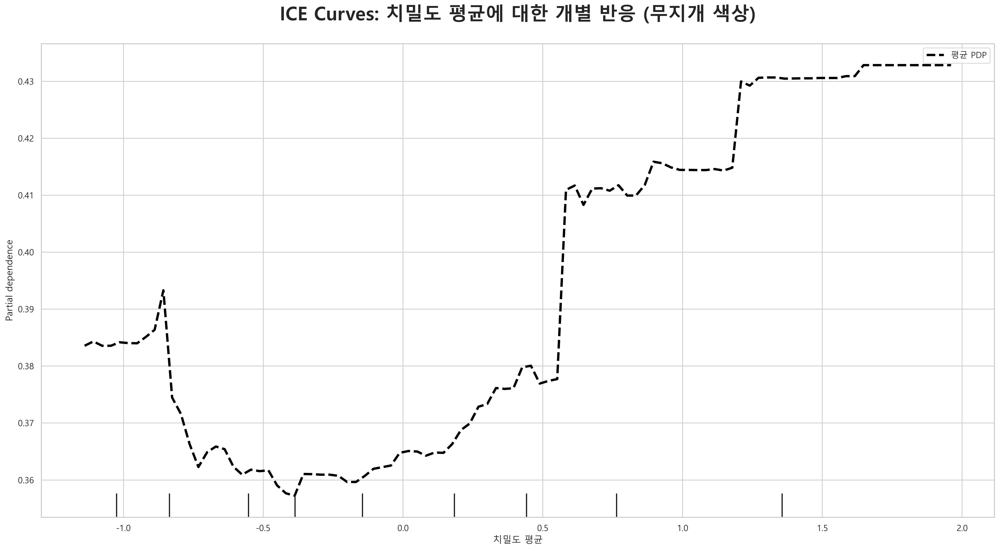

✅ ICE Curves 완료!


In [78]:
# ============================================
# XAI 5: ICE (Individual Conditional Expectation) Curves
# ============================================
print("=" * 50)
print("XAI 5: ICE Curves")
print("=" * 50)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
from matplotlib import colormaps  # get_cmap 대체
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import PartialDependenceDisplay

# --------------------------------------------
# 0. df_scaled, diagnosis 존재 여부 확인
# --------------------------------------------
if 'df_scaled' not in globals():
    raise RuntimeError("df_scaled 데이터프레임이 정의되어 있지 않습니다. 앞에서 전처리 셀을 먼저 실행해 주세요.")

if '진단' not in df_scaled.columns:
    raise RuntimeError("df_scaled 안에 '진단' 컬럼이 없습니다. 타깃 컬럼 이름을 확인해 주세요.")

# --------------------------------------------
# 1. 한글 폰트 재확인 및 적용
# --------------------------------------------
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

# --------------------------------------------
# 2. X, y 구성 + NaN/inf 처리 (행 버리지 않고 보간)
# --------------------------------------------

# 2-1) X: diagnosis(문자)만 제외하고 나머지 수치형/스케일된 컬럼 사용
X = df_scaled.drop(columns=['진단'], errors="ignore").copy()

# 2-2) y: target(0/1)가 있으면 사용, 없으면 diagnosis 처리
if "target" in df_scaled.columns:
    y_label = df_scaled["target"].copy()
    print("y_label: df_scaled['target'] 사용")
elif "진단" in df_scaled.columns:
    # diagnosis가 이미 숫자형(0/1)인지 확인
    if df_scaled["진단"].dtype in [np.int64, np.float64, int, float]:
        # 이미 숫자형이면 그대로 사용
        y_label = df_scaled["진단"].copy()
        print("y_label: df_scaled['진단'] (이미 숫자형) 사용")
    else:
        # 문자열이면 매핑
        y_label = df_scaled["진단"].map({"B": 0, "M": 1, "양성(B)": 0, "악성(M)": 1})
        print("y_label: diagnosis를 B=0, M=1로 매핑해서 사용")
else:
    raise RuntimeError("df_scaled에 'target' 또는 '진단' 컬럼이 없습니다.")

# 2-3) y NaN 있는 행은 버림 (진짜 타깃이 없는 행은 쓸 수 없으니까)
mask_y_valid = ~y_label.isna()
X = X.loc[mask_y_valid].copy()
y_label = y_label.loc[mask_y_valid].copy()

print(f"y NaN 제거 후 샘플 수: {len(X)}")

if len(X) == 0:
    raise RuntimeError("타깃 y가 NaN이 아닌 샘플이 없습니다. 원본 데이터의 '진단'를 확인해 주세요.")

# 2-4) X 안의 inf → NaN으로 바꾼 뒤, 각 컬럼별 중앙값으로 채우기
X = X.replace([np.inf, -np.inf], np.nan)

# 중앙값 계산 (전부 NaN인 컬럼은 중앙값도 NaN이지만 Breast Cancer 데이터에선 거의 없을 것)
median_values = X.median(numeric_only=True)

# NaN을 중앙값으로 채우기
X = X.fillna(median_values)

# 그래도 혹시 남아있으면, 그때만 행 드랍 (극단 상황 대비)
mask_X_valid = ~X.isna().any(axis=1)
X_clean = X.loc[mask_X_valid].copy()
y_clean = y_label.loc[mask_X_valid].copy()

print(f"NaN/inf 처리 후 샘플 수: {len(X_clean)}")

if len(X_clean) == 0:
    raise RuntimeError("NaN/inf 처리 후 남은 샘플이 없습니다. df_scaled 전처리를 다시 확인해 주세요.")

# --------------------------------------------
# 3. train/test 분할 + 모델 준비
# --------------------------------------------
# stratify를 쓰려면 클래스가 최소 2개 있어야 함
if y_clean.nunique() < 2:
    raise RuntimeError("y가 하나의 클래스만 포함하고 있습니다. ICE를 그리려면 양성/악성 두 클래스가 모두 필요합니다.")

X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y_clean,
    test_size=0.2,
    random_state=42,
    stratify=y_clean
)

# rf_clf 가 이미 있으면 재사용, 없으면 새로 학습
if 'rf_clf' not in globals():
    rf_clf = RandomForestClassifier(
        n_estimators=200,
        max_depth=None,
        random_state=42,
        n_jobs=-1
    )
    rf_clf.fit(X_train, y_train)
    print("✅ RandomForest 새로 학습 완료 후 ICE 계산 진행")
else:
    print("✅ 기존 rf_clf 모델 사용하여 ICE 계산 진행")

# --------------------------------------------
# 4. ICE에 사용할 feature 설정
# --------------------------------------------
default_feature_name = '치밀도 평균'

if default_feature_name in X_test.columns:
    feature_name = default_feature_name
else:
    numeric_cols = X_test.select_dtypes(include=[np.number]).columns.tolist()
    if len(numeric_cols) == 0:
        raise RuntimeError("수치형 특징이 없습니다. ICE 곡선을 그릴 특징이 필요합니다.")
    feature_name = numeric_cols[0]
    print(f"⚠️ '{default_feature_name}' 컬럼을 찾을 수 없어 '{feature_name}' 컬럼으로 ICE를 그립니다.")

feature_idx = X_test.columns.get_loc(feature_name)

# --------------------------------------------
# 5. ICE 곡선 샘플 선택 & 계산
# --------------------------------------------
try:
    sample_size = min(50, len(X_test))
    if sample_size == 0:
        raise RuntimeError("X_test가 비어있어 ICE 곡선을 계산할 수 없습니다.")
    
    # X_test 인덱스로 샘플 선택 (DataFrame 유지)
    sample_indices = np.random.choice(X_test.index, sample_size, replace=False)
    X_test_ice = X_test.loc[sample_indices].copy()
    
    print(f"ICE 곡선 계산 중... (샘플 {sample_size}개 사용, 특징: {feature_name})")
    
    fig, ax = plt.subplots(figsize=(18, 10), dpi=300)
    
    # 최신 Matplotlib 방식: colormaps.get_cmap 사용
    rainbow = colormaps.get_cmap('hsv')
    # 샘플 수에 맞게 0~1 범위에서 균등하게 색상 생성
    color_values = np.linspace(0, 1, sample_size)
    colors = [rainbow(val) for val in color_values]
    
    # 특징 값 범위 설정
    feature_values = np.linspace(
        X_test[feature_name].min(),
        X_test[feature_name].max(),
        50
    )
    
    # 개별 ICE 곡선 (각 샘플별)
    for idx, (row_idx, base_row) in enumerate(X_test_ice.iterrows()):
        base_df = base_row.to_frame().T  # (1, n_features)
        ice_values = []
        
        for fv in feature_values:
            row_df = base_df.copy()
            row_df[feature_name] = fv
            proba = rf_clf.predict_proba(row_df)[0, 1]  # class=1(악성) 확률
            ice_values.append(proba)
        
        ax.plot(
            feature_values,
            ice_values,
            color=colors[idx],
            alpha=0.65,
            linewidth=1.5
            # label 없음 → 레전드에는 PDP만 표시
        )
    
    # ----------------------------------------
    # 6. 평균 PDP 곡선 (검은 점선)
    # ----------------------------------------
    PartialDependenceDisplay.from_estimator(
        rf_clf,
        X_test,
        features=[feature_name],
        kind='average',
        ax=ax,
        line_kw={
            'color': 'black',
            'linewidth': 3,
            'linestyle': '--',
            'label': '평균 PDP'
        }
    )
    
    # ----------------------------------------
    # 7. 레이블 / 제목 / 레전드
    # ----------------------------------------
    title_text = f'ICE Curves: {feature_name}에 대한 개별 반응 (무지개 색상)'
    
    if selected_font:
        ax.set_xlabel(f'{feature_name}', fontsize=22, fontweight='bold', fontfamily=selected_font)
        ax.set_ylabel('악성 확률', fontsize=22, fontweight='bold', fontfamily=selected_font)
        ax.set_title(title_text, fontsize=24, fontweight='bold', pad=30, fontfamily=selected_font)
    else:
        ax.set_xlabel(f'{feature_name}', fontsize=22, fontweight='bold')
        ax.set_ylabel('악성 확률', fontsize=22, fontweight='bold')
        ax.set_title(title_text, fontsize=24, fontweight='bold', pad=30)
    
    ax.grid(True, alpha=0.3, linestyle='--')
    ax.tick_params(axis='both', which='major', labelsize=16)
    
    handles, labels = ax.get_legend_handles_labels()
    if handles:
        if selected_font:
            ax.legend(handles, labels, fontsize=18, loc='best', prop={'family': selected_font})
        else:
            ax.legend(handles, labels, fontsize=18, loc='best')
    
    plt.tight_layout()
    plt.show()
    
    print("✅ ICE Curves 완료!")
    
except Exception as exc:
    print(f"❌ ICE 곡선 계산 중 오류 발생: {exc}")
    import traceback
    traceback.print_exc()
    plt.close()


In [79]:
# ============================================
# 의사결정나무 시각화
# ============================================
print("=" * 50)
print("의사결정나무 구조 시각화")
print("=" * 50)

# 한글 폰트 재확인 및 적용
import matplotlib.font_manager as fm
font_list = [font.name for font in fm.fontManager.ttflist]
korean_fonts = ['Malgun Gothic', 'NanumGothic', 'NanumBarunGothic', 'AppleGothic', 'Gulim']
selected_font = None
for font in korean_fonts:
    if font in font_list:
        selected_font = font
        break

if selected_font:
    plt.rcParams['font.family'] = selected_font
    plt.rcParams['axes.unicode_minus'] = False

from sklearn.tree import plot_tree

# X 변수 확인 및 준비
if 'X' not in globals() or X is None:
    # df_scaled에서 X 생성
    ensure_df_scaled()
    X = df_scaled.drop(columns=['진단'], errors='ignore')
    print("X 변수를 새로 생성했습니다.")

# dt_clf 확인
if 'dt_clf' not in globals():
    print("⚠️ dt_clf가 없습니다. 먼저 모델 학습 셀을 실행해주세요.")
    raise RuntimeError("dt_clf 모델이 필요합니다.")

# 트리 전체 깊이 확인
max_depth_actual = dt_clf.tree_.max_depth
print(f"의사결정나무 최대 깊이: {max_depth_actual}")

# 트리 노드 수 확인
n_nodes = dt_clf.tree_.node_count
print(f"트리 노드 수: {n_nodes}")

# 그래프 크기를 노드 수에 따라 동적으로 조정
fig_width = max(30, min(50, n_nodes * 0.5))
fig_height = max(20, min(30, max_depth_actual * 3))

plt.figure(figsize=(fig_width, fig_height), dpi=300)
plot_tree(
    dt_clf, 
    feature_names=X.columns.tolist(), 
    class_names=['양성(B)', '악성(M)'], 
    filled=True, 
    rounded=True, 
    max_depth=None,  # 전체 트리 표시
    fontsize=16,  # 폰트 크기
    precision=2,
    proportion=False  # 샘플 수 표시
)

if selected_font:
    plt.title('의사결정나무 구조 (전체 트리)', 
              fontsize=28, fontweight='bold', pad=35, fontfamily=selected_font)
else:
    plt.title('의사결정나무 구조 (전체 트리)', 
              fontsize=28, fontweight='bold', pad=35)

plt.tight_layout()
plt.show()

print("의사결정나무 시각화 완료!")


의사결정나무 구조 시각화
의사결정나무 최대 깊이: 5
트리 노드 수: 35


의사결정나무 시각화 완료!
